In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Installing required packages

In [ ]:
pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 564 kB 5.2 MB/s 


In [ ]:
pip install mne

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 7.5 MB 4.2 MB/s 


In [ ]:
pip install antropy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 49 kB 3.2 MB/s 
  Created wheel for antropy: filename=antropy-0.1.4-py3-none-any.whl size=16159 sha256=291400ebe2626b657c9a8373108f82b5ad8484d9d1be10ed3bc5f019b553bd1b
  Stored in directory: /root/.cache/pip/wheels/d4/cc/6b/28fa7036bdabc6f1f92fd6a108ae259dbb48f107f676d6b491
Successfully built antropy


# Feature Extraction

In [ ]:
import mne
import shap
import antropy as ant

In [ ]:
import os
from os import listdir
from os.path import isfile, join

import matplotlib.pyplot as plt
import scipy.io
from scipy.signal import butter, lfilter

import pandas as pd
import numpy as np

import seaborn as sns
sns.set(font_scale=1.2)

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.inspection import permutation_importance
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold


In [ ]:
SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

Creating RawArray with float64 data, n_channels=128, n_times=1
    Range : 0 ... 0 =      0.000 ...     0.000 secs
Ready.


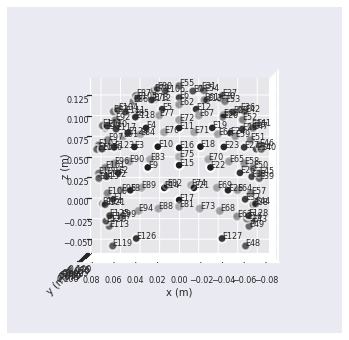

In [ ]:
#to import the data instance
montage = mne.channels.make_standard_montage('GSN-HydroCel-128')

#Visualizing Montage positions
fig = montage.plot(kind='3d',scale_factor = 10)

In [ ]:
#Function to import the dataset, make some cleanups and return the data
montage = mne.channels.make_standard_montage('GSN-HydroCel-128')

def file_importer(path='/content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015/02010002erp 20150416 1131.raw',type =1):
  """
  Inputs:
  path = Location of the raw file
  type = 1 / 0 indicating raw or mat format
  Outputs:
  Returns the .raw object for EEG
  """
  if type == 1:
    df = mne.io.read_raw_egi(path,verbose=True)
    #Delete the bad signal that we identified
    df.drop_channels('E129')
    #Just set the montage - Though the research institution provided us the montage file, 
    #there are numerous challenges importing the file as the matlab native format is not set in the 
    #mne package. As a result, we will be utilizing make_standard_montage file present in the mne library -- 
    #As the machine that was used is related to 'GSN_HydroCel-129'. However, kindly ensure that we are 
    #deleting the dead signal E129
  else:
    ch_names = ['E'+str(i+1) for i in range(128)]
    sampling_freq = 250
    mat = scipy.io.loadmat(path)
    key = list(mat.keys())
    data = key[3]
    a_mat = mat[data]
    info = mne.create_info(ch_names= ch_names,
                       ch_types='eeg', verbose=None,
                       sfreq=sampling_freq)
    df = mne.io.RawArray(a_mat[:-1,:], info)

  df.set_montage(montage)
  #df = df.pick_channels(ch_names = list(Electrode_map.values()))
  df.plot_psd()
  return df

Reading EGI header from /content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015/02010002erp 20150416 1131.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {SESS} ...
    Found multiple events at the same time sample. Cannot create trigger channel.
Effective window size : 8.192 (s)


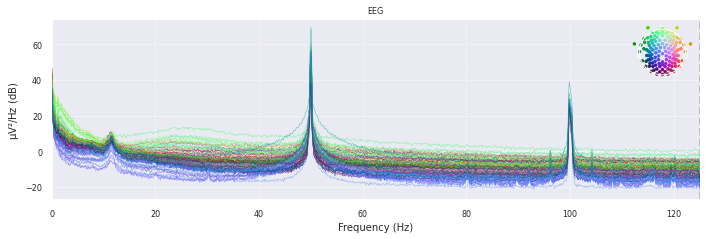

In [ ]:
raw_erp = file_importer()

Creating RawArray with float64 data, n_channels=128, n_times=78639
    Range : 0 ... 78638 =      0.000 ...   314.552 secs
Ready.
Effective window size : 8.192 (s)


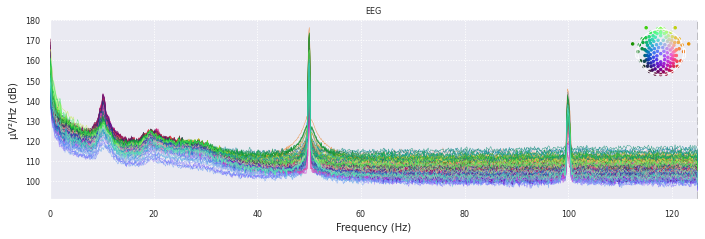

In [ ]:
#Sample Output
raw_rest = file_importer('/content/drive/My Drive/dep_data/MODMA/EEG_128channels_resting_lanzhou_2015/02010006rest 20150528 0928..mat',type = 0)

In [ ]:
#Electrodes to be considered -
#Source - https://www.egi.com/images/HydroCelGSN_10-10.pdf

Electrode_map = {'C3':'E36','C4':'E104','F3':'E24','F4':'E124','F7':'E33','F8':'E122',
                 'FP1':'E22','FP2':'E9','O1':'E70','O2':'E83','P3':'E52','P4':'E92',
                 'T3-T7':'E45','T4-T8':'E108','T5-P7':'E58','T6-P8':'E96'}
Electrode_understanding = {'Left-Central':'E36','Right-Central':'E104','Front-Left':'E24','Front-Right':'E124',
                           'Front-Far left':'E33','Front-Far Right':'E122',
                           'Forehead (above left eye)':'E22','Forehead (above Right eye)':'E9',
                           'Back-left to Center':'E70','Back-Right to Center':'E83','Back-Above E70':'E52',
                           'Back-Above E83':'E92','Side Left':'E45','Side Right':'E108','Left':'E58','Right':'E96'}

#Electrodes to pick
list(Electrode_map.values())

['E36',
 'E104',
 'E24',
 'E124',
 'E33',
 'E122',
 'E22',
 'E9',
 'E70',
 'E83',
 'E52',
 'E92',
 'E45',
 'E108',
 'E58',
 'E96']

Effective window size : 8.192 (s)


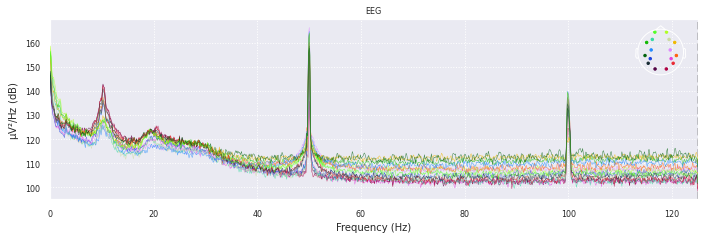

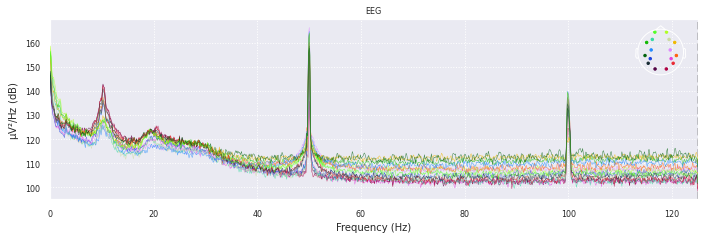

In [ ]:
#Checking out if we filter for 16 electrodes

raw_rest.pick_channels(list(Electrode_map.values())).plot_psd()

## designing band pass filter

Initial Power distribution
After filtering - Power distribution
Reading 0 ... 197401  =      0.000 ...   789.604 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Effective window size : 8.192 (s)


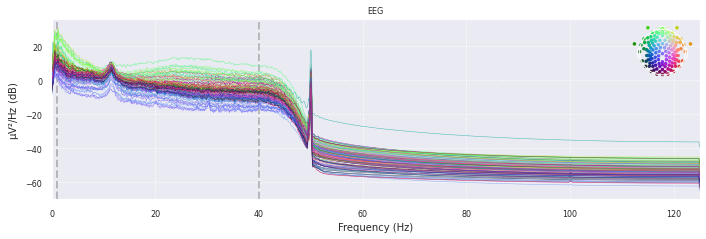

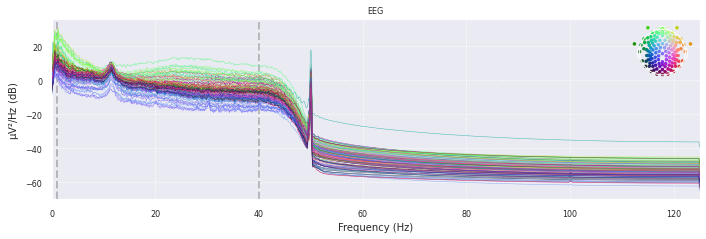

In [ ]:
sampling_freq = 250
# the EEG data were filtered (bandpass = 1–40 Hz) using a Hamming windowed Sinc FIR filter
l_freq = 1
h_freq = 40
# Applying filters
def raw_trunc(simulated_raw):
  simulated_raw =simulated_raw.copy().load_data()
  simulated_raw_truc = simulated_raw.filter(l_freq,h_freq,method = 'fir',fir_window = 'hamming')
  return simulated_raw_truc

print("Initial Power distribution")
#raw = file_importer()
print("After filtering - Power distribution")
raw_trunct = raw_trunc(raw_erp)
raw_trunct.plot_psd()

In [ ]:
def butter_bandpass_filter(data):
  """
  Inputs :
  data -Raw eeg data
  lowcut-low pass frequency
  highcut-high pass frequency
  fs-sampling frequenct
  Order - Order at which filter needs to be designed
  Outputs:
  y - Filtered signal
  """
  fs = 256                                # Sampling rate (256 Hz)
  eeg_bands = {'delta':(1,4),
               'Theta': (4, 8),
               'Alpha': (8, 12),
               'Beta': (12, 30),
               'Gamma': (30, 45),
               'Normal':(0,40)}
  # Get real amplitudes of FFT (only in postive frequencies)
  fft_vals = np.absolute(np.fft.rfft(data))
  # Get frequencies for amplitudes in Hz
  fft_freq = np.fft.rfftfreq(len(data), 1.0/fs)

  # Take the mean of the fft amplitude for each EEG band
  eeg_band_mean = dict()
  eeg_band_median = dict()
  eeg_band_max = dict()
  eeg_band_min = dict()
  eeg_band_fft = dict()
  for band in eeg_bands:  
    freq_ix = np.where((fft_freq >= eeg_bands[band][0]) & 
                      (fft_freq <= eeg_bands[band][1]))[0]
    eeg_band_fft[band] = np.mean(fft_vals[freq_ix])
    eeg_band_median[band] = np.median(fft_vals[freq_ix])
    eeg_band_mean[band] = np.mean(fft_vals[freq_ix])
    eeg_band_max[band] = np.max(fft_vals[freq_ix])
    eeg_band_min[band] = np.min(fft_vals[freq_ix])

  return eeg_band_mean,eeg_band_median,eeg_band_max,eeg_band_min,eeg_band_fft

## Linear Features

In [ ]:
def signal_extractor(df,prefix):
  """
  Input:
  df - .raw object : EEG Waveform data
  prefix - It is used to name the columns
  Output:
  returns 'result'. It is a pandas dataframe with dimensions 149*8 (128 electrodes
  +21 event trigger stim channels (More details to follow) each having 8 features)
  """

  d = df.get_data()  
  ch_names = df.ch_names
  val_dict = dict()
  for i in np.arange(d.shape[0]):
      data = d[i,:]
      eeg_band_mean,eeg_band_median,eeg_band_max,eeg_band_min,eeg_band_fft = butter_bandpass_filter(data)
      mean = eeg_band_mean['Normal']
      max = eeg_band_max['Normal']
      min = eeg_band_min['Normal']
      median = eeg_band_median['Normal']
      alpha = eeg_band_fft['Alpha']
      beta = eeg_band_fft['Beta']
      delta = eeg_band_fft['delta']
      theta = eeg_band_fft['Theta']
      objects = [alpha, beta, delta,theta,mean,max,min,median]
      val_dict[ch_names[i]] = objects
  result = pd.DataFrame(val_dict).T
  result.columns = ['lf_alpha_'+prefix,'lf_beta_'+prefix,'lf_delta_'+prefix,'lf_theta_'+prefix,'lf_mean_'+prefix,'lf_max_'+prefix,'lf_min_'+prefix,'lf_median_'+prefix]
  return result

In [ ]:
signal_extractor(raw_erp,'one_pat').head()

,lf_alpha_one_pat,lf_beta_one_pat,lf_delta_one_pat,lf_theta_one_pat,lf_mean_one_pat,lf_max_one_pat,lf_min_one_pat,lf_median_one_pat
E1,0.009197,0.004703,0.029170,0.011922,0.020509,126.454099,0.000036,0.004709
E2,0.008355,0.004442,0.030665,0.010765,0.056791,1315.108658,0.000027,0.004451
E3,0.010076,0.006516,0.041635,0.014003,0.090575,2109.456340,0.000040,0.006722
E4,0.010546,0.005984,0.041639,0.014799,0.040119,526.747381,0.000038,0.006238
E5,0.010841,0.005423,0.044506,0.016488,0.054184,884.714861,0.000066,0.005555


## Non-linear Features


In [ ]:
#Non Linear Features
def nli_features(df,prefix):
  """
  Input:
  df - .raw object : EEG Waveform data
  prefix - It is used to name the columns
  Output:
  returns 'result'. It is a pandas dataframe with dimensions 149*2 (128 electrodes
  +21 event trigger stim channels (More details to follow) each having 2 features)
  """
  ch_names = df.ch_names
  val_dict = dict()
  overall = raw_trunc(df.copy())
  d = overall.get_data()  
  # Extract Non Linear features
  for i in range(d.shape[0]):
    signal = d[i,:]
    svd_entropy = ant.svd_entropy(signal, normalize=True)
    spectral_entropy = ant.spectral_entropy(signal, sf=250, method='welch', normalize=True)
    perm_entropy = ant.perm_entropy(d[i,:], normalize=True)
    #app_entropy = ant.app_entropy(d[i,:])
    #sample_entropy = ant.sample_entropy(d[i,:])
    
    #objects = [svd_entropy,spectral_entropy,perm_entropy,app_entropy,sample_entropy]
    objects = [svd_entropy,spectral_entropy,perm_entropy]
    val_dict[ch_names[i]] = objects
  result = pd.DataFrame(val_dict).T
  #result.columns = ['nl_svden_'+prefix,'nl_spec_en'+prefix,'nl_permen'+prefix,'nl_appen'+prefix,'nl_sampen'+prefix]
  result.columns = ['nl_svden_'+prefix,'nl_spec_en'+prefix,'nl_permen'+prefix]
  return result

In [ ]:
#Sample output
nli_features(raw_erp,'one_pat').head()

Reading 0 ... 197401  =      0.000 ...   789.604 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



,nl_svden_one_pat,nl_spec_enone_pat,nl_permenone_pat
E1,0.472424,0.490312,0.783087
E2,0.460892,0.467293,0.778375
E3,0.574941,0.546001,0.803617
E4,0.598420,0.585663,0.826692
E5,0.576004,0.600490,0.819386


## Preprocessing filters

In [ ]:
def channel_explorer(df):
  """
  Input
  df - EEG Waveform from the simulated experiment
  Output
  returns -
  Happy waveform, Sad waveform, Fear waveform 
  as a tuple
  """
  #Select only the STIM channels (channels that stores impulses)
  list_channels = df.copy().pick_types(meg=False, stim=True).ch_names
  #Get the data in numpy format
  temp = pd.DataFrame(df.copy().pick_types(meg=False, stim=True).get_data().T)
  #Set the column names as per the incoming electrode positions
  temp.columns = list_channels
  temp.reset_index(inplace = True)

  #initialization
  df_happy = pd.DataFrame()
  df_sad = pd.DataFrame()
  df_fear = pd.DataFrame()

  #Loop to go through each emotion and output the values
  for col in temp.columns:
    if col!='index':
      if col in ['fcue', 'fdot','ffix', 'fisi', 'fwrp']:
        te = pd.DataFrame(temp[temp[col]==1].agg({'index':['max','min']}))
        te.columns = [col]
        df_fear = pd.concat([df_fear,te],axis = 1)
      if col in ['hcue', 'hdot', 'hfix', 'hisi', 'hwrp']:
        te = pd.DataFrame(temp[temp[col]==1].agg({'index':['max','min']}))
        te.columns = [col]
        df_happy = pd.concat([df_happy,te],axis = 1)
      if col in ['scue', 'sdot', 'sfix', 'sisi', 'swrp']:
        te = pd.DataFrame(temp[temp[col]==1].agg({'index':['max','min']}))
        te.columns = [col]
        df_sad = pd.concat([df_sad,te],axis = 1)
  event_dict = {'fear':(np.min(df_fear,axis = 1)[1],np.max(df_fear,axis = 1)[0]),
                'sad':(np.min(df_sad,axis = 1)[1],np.max(df_sad,axis = 1)[0]),
                'happy':(np.min(df_happy,axis = 1)[1],np.max(df_happy,axis = 1)[0])}
  print(event_dict)
  #Check for sequence
  sequence_order = np.argsort([i[0] for i in list(event_dict.values())])
  vals = list(event_dict.keys())
  sequence = [vals[i] for i in sequence_order]
  print(sequence)
  print(event_dict[sequence[0]][1])
  print(event_dict[sequence[1]][0])
  print(event_dict[sequence[1]][1])
  print(event_dict[sequence[2]][0])
  #Check for overlaps
  val = 0
  if (event_dict[sequence[0]][1]>event_dict[sequence[1]][0]) or (event_dict[sequence[1]][1]>event_dict[sequence[2]][0]):
    val = 1
    print("Problem with event spacings - Kindly check")
  fear_raw = df.copy().crop(tmin=event_dict['fear'][0]/250,tmax=event_dict['fear'][1]/250)
  happy_raw = df.copy().crop(tmin=event_dict['happy'][0]/250,tmax=event_dict['happy'][1]/250)
  sad_raw = df.copy().crop(tmin=event_dict['sad'][0]/250,tmax=event_dict['sad'][1]/250)
  return fear_raw,happy_raw,sad_raw

## Getting all data: and Data cleaning

File name  02010006erp 20150528 1007.raw Position  0
Reading EGI header from /content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015/02010006erp 20150528 1007.raw...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {D127, D255, DI18, DI26, DI95, SESS} ...
Effective window size : 8.192 (s)


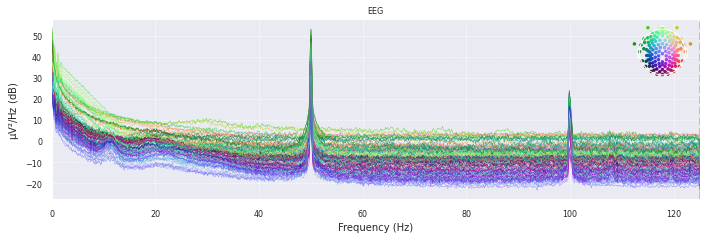

{'fear': (129371, 194827), 'sad': (296, 64502), 'happy': (64694, 129200)}
['sad', 'happy', 'fear']
64502
64694
129200
129371
Reading 0 ... 65456  =      0.000 ...   261.824 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 64506  =      0.000 ...   258.024 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64206  =      0.000 ...   256.824 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

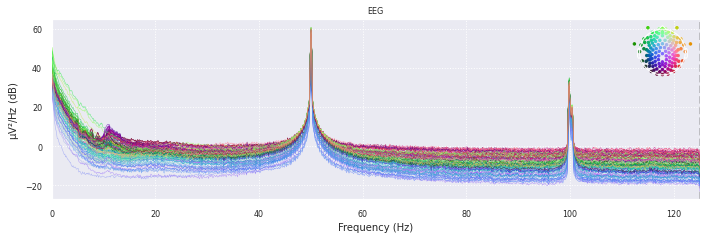

{'fear': (153660, 232695), 'sad': (298, 70805), 'happy': (71116, 153368)}
['sad', 'happy', 'fear']
70805
71116
153368
153660
Reading 0 ... 79035  =      0.000 ...   316.140 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 82252  =      0.000 ...   329.008 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 70507  =      0.000 ...   282.028 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

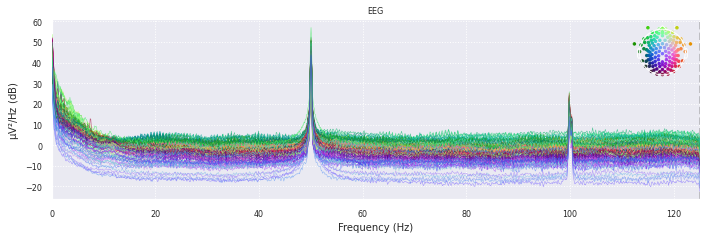

{'fear': (134154, 200861), 'sad': (301, 67161), 'happy': (67353, 133947)}
['sad', 'happy', 'fear']
67161
67353
133947
134154
Reading 0 ... 66707  =      0.000 ...   266.828 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66594  =      0.000 ...   266.376 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66860  =      0.000 ...   267.440 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

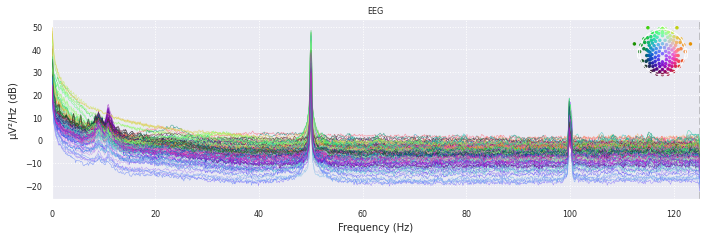

{'fear': (292, 72881), 'sad': (144383, 215856), 'happy': (73123, 144104)}
['fear', 'happy', 'sad']
72881
73123
144104
144383
Reading 0 ... 72589  =      0.000 ...   290.356 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 70981  =      0.000 ...   283.924 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 71473  =      0.000 ...   285.892 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

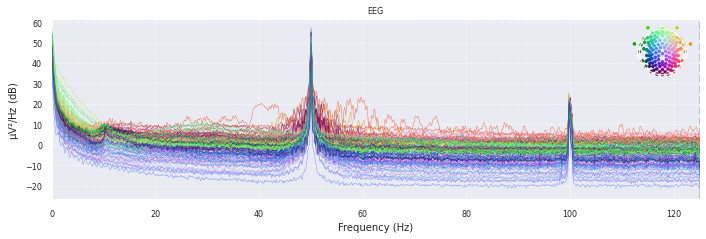

{'fear': (590, 71193), 'sad': (145149, 214013), 'happy': (71405, 144932)}
['fear', 'happy', 'sad']
71193
71405
144932
145149
Reading 0 ... 70603  =      0.000 ...   282.412 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 73527  =      0.000 ...   294.108 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68864  =      0.000 ...   275.456 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

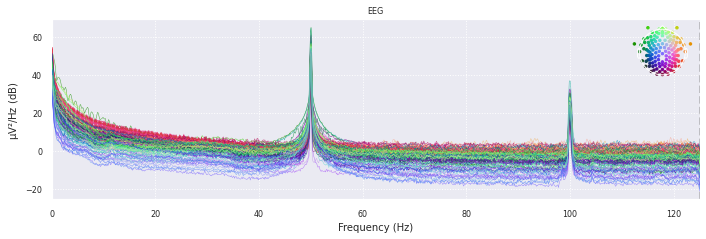

{'fear': (66428, 134697), 'sad': (134942, 203403), 'happy': (315, 66221)}
['happy', 'fear', 'sad']
66221
66428
134697
134942
Reading 0 ... 68269  =      0.000 ...   273.076 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 65906  =      0.000 ...   263.624 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68461  =      0.000 ...   273.844 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

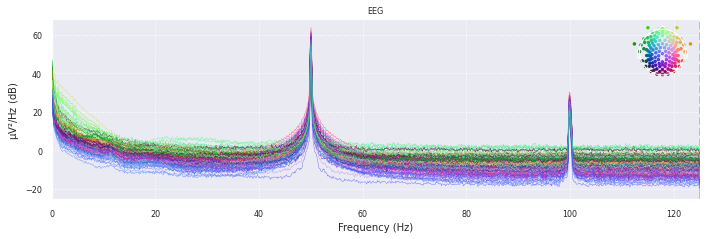

{'fear': (140401, 210603), 'sad': (70148, 139771), 'happy': (318, 69953)}
['happy', 'sad', 'fear']
69953
70148
139771
140401
Reading 0 ... 70202  =      0.000 ...   280.808 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 69635  =      0.000 ...   278.540 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 69623  =      0.000 ...   278.492 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

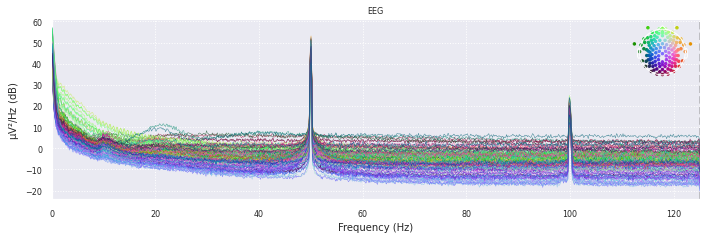

{'fear': (134809, 201707), 'sad': (305, 67686), 'happy': (67883, 134606)}
['sad', 'happy', 'fear']
67686
67883
134606
134809
Reading 0 ... 66898  =      0.000 ...   267.592 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66723  =      0.000 ...   266.892 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67381  =      0.000 ...   269.524 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

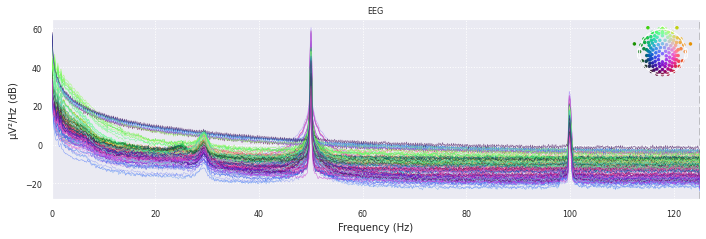

{'fear': (134438, 201457), 'sad': (66870, 134222), 'happy': (297, 66678)}
['happy', 'sad', 'fear']
66678
66870
134222
134438
Reading 0 ... 67019  =      0.000 ...   268.076 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66381  =      0.000 ...   265.524 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67352  =      0.000 ...   269.408 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

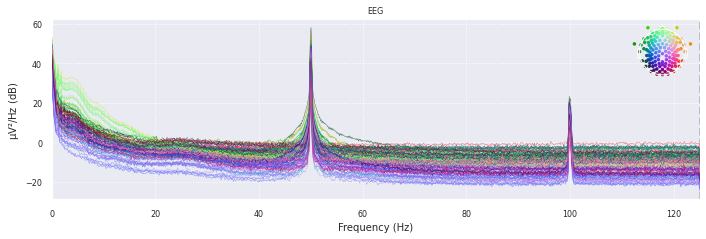

{'fear': (312, 67293), 'sad': (134228, 201080), 'happy': (67476, 134032)}
['fear', 'happy', 'sad']
67293
67476
134032
134228
Reading 0 ... 66981  =      0.000 ...   267.924 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66556  =      0.000 ...   266.224 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66852  =      0.000 ...   267.408 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

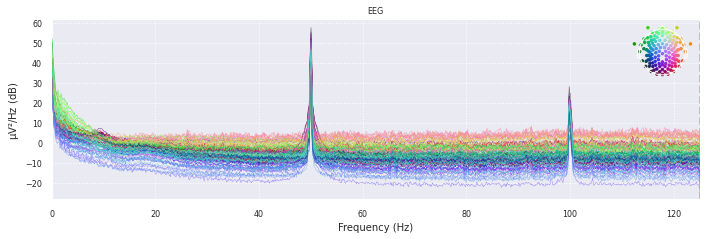

{'fear': (131211, 195876), 'sad': (321, 65081), 'happy': (65276, 131024)}
['sad', 'happy', 'fear']
65081
65276
131024
131211
Reading 0 ... 64665  =      0.000 ...   258.660 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65748  =      0.000 ...   262.992 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64760  =      0.000 ...   259.040 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

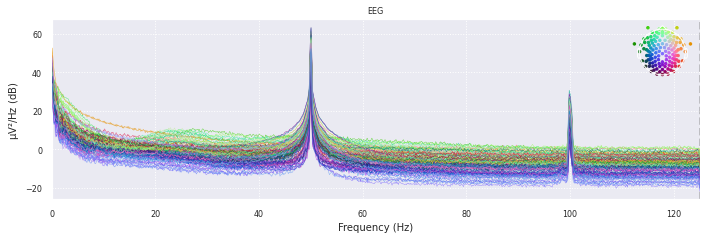

{'fear': (296, 67748), 'sad': (67930, 136057), 'happy': (136318, 204891)}
['fear', 'sad', 'happy']
67748
67930
136057
136318
Reading 0 ... 67452  =      0.000 ...   269.808 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 68573  =      0.000 ...   274.292 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68127  =      0.000 ...   272.508 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

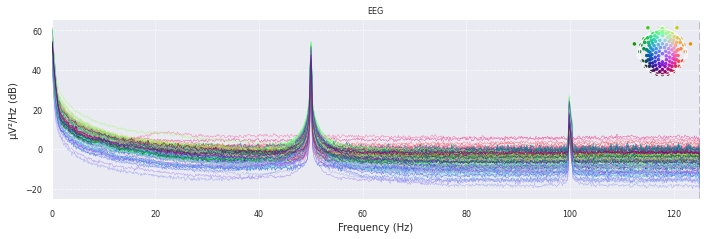

{'fear': (66631, 134350), 'sad': (134529, 200927), 'happy': (580, 66420)}
['happy', 'fear', 'sad']
66420
66631
134350
134529
Reading 0 ... 67719  =      0.000 ...   270.876 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65840  =      0.000 ...   263.360 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66398  =      0.000 ...   265.592 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

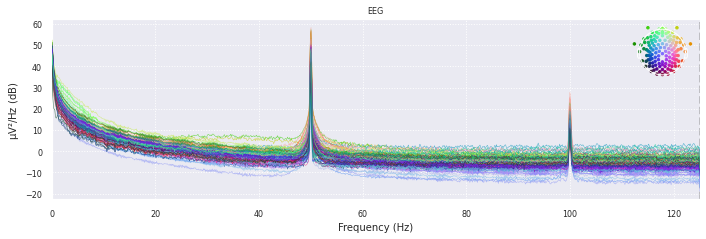

{'fear': (299, 70476), 'sad': (141464, 210837), 'happy': (70688, 141257)}
['fear', 'happy', 'sad']
70476
70688
141257
141464
Reading 0 ... 70177  =      0.000 ...   280.708 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 70569  =      0.000 ...   282.276 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 69373  =      0.000 ...   277.492 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

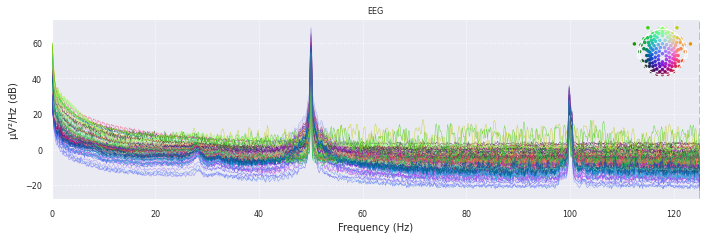

{'fear': (132778, 198289), 'sad': (67577, 132558), 'happy': (588, 67374)}
['happy', 'sad', 'fear']
67374
67577
132558
132778
Reading 0 ... 65511  =      0.000 ...   262.044 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66786  =      0.000 ...   267.144 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64981  =      0.000 ...   259.924 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

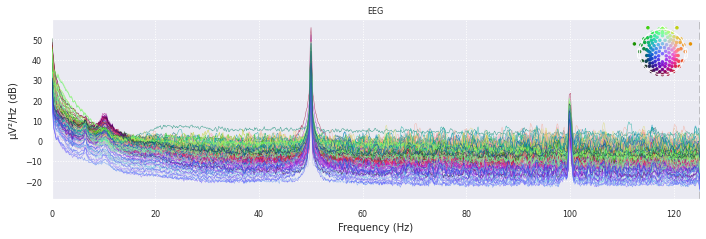

{'fear': (137185, 208583), 'sad': (298, 67896), 'happy': (68083, 136997)}
['sad', 'happy', 'fear']
67896
68083
136997
137185
Reading 0 ... 71398  =      0.000 ...   285.592 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 68914  =      0.000 ...   275.656 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67598  =      0.000 ...   270.392 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

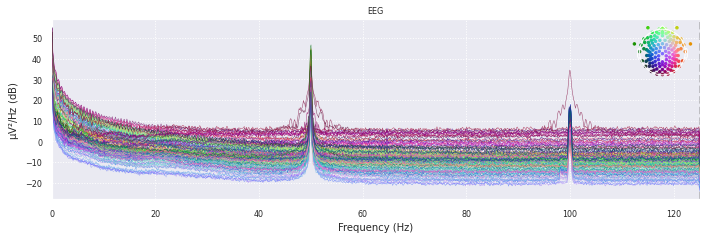

{'fear': (72109, 143582), 'sad': (294, 71854), 'happy': (143831, 215917)}
['sad', 'fear', 'happy']
71854
72109
143582
143831
Reading 0 ... 71473  =      0.000 ...   285.892 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 72086  =      0.000 ...   288.344 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 71560  =      0.000 ...   286.240 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

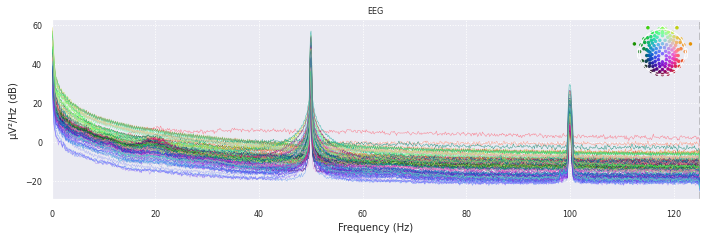

{'fear': (68213, 135136), 'sad': (135346, 203361), 'happy': (304, 68006)}
['happy', 'fear', 'sad']
68006
68213
135136
135346
Reading 0 ... 66923  =      0.000 ...   267.692 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 67702  =      0.000 ...   270.808 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68015  =      0.000 ...   272.060 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

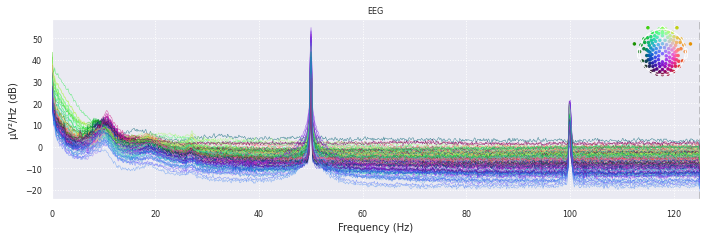

{'fear': (66991, 132860), 'sad': (315, 66805), 'happy': (133047, 200578)}
['sad', 'fear', 'happy']
66805
66991
132860
133047
Reading 0 ... 65869  =      0.000 ...   263.476 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 67531  =      0.000 ...   270.124 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66490  =      0.000 ...   265.960 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

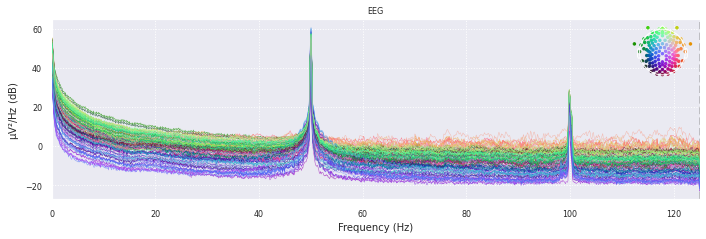

{'fear': (129826, 194824), 'sad': (298, 65242), 'happy': (65454, 129627)}
['sad', 'happy', 'fear']
65242
65454
129627
129826
Reading 0 ... 64998  =      0.000 ...   259.992 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64173  =      0.000 ...   256.692 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64944  =      0.000 ...   259.776 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

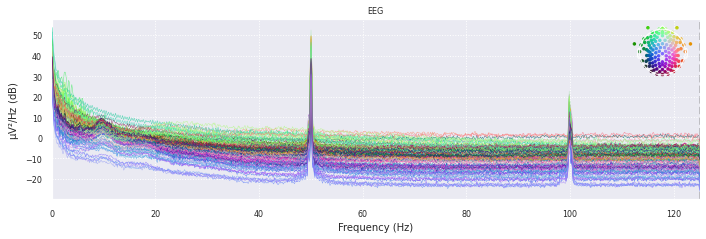

{'fear': (133688, 198212), 'sad': (294, 65030), 'happy': (69262, 133494)}
['sad', 'happy', 'fear']
65030
69262
133494
133688
Reading 0 ... 64524  =      0.000 ...   258.096 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64232  =      0.000 ...   256.928 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64736  =      0.000 ...   258.944 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

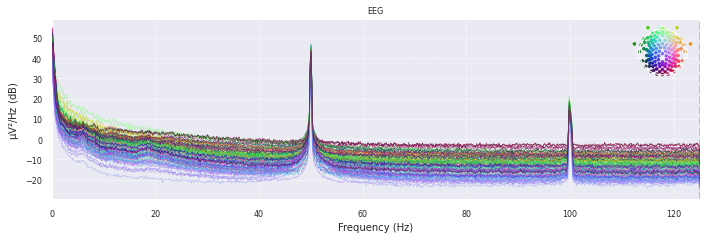

{'fear': (134791, 201018), 'sad': (304, 67060), 'happy': (67281, 134575)}
['sad', 'happy', 'fear']
67060
67281
134575
134791
Reading 0 ... 66227  =      0.000 ...   264.908 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 67294  =      0.000 ...   269.176 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66756  =      0.000 ...   267.024 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

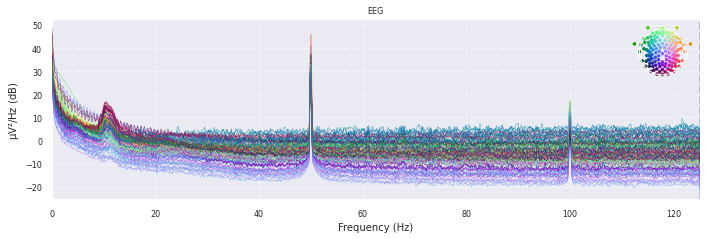

{'fear': (75693, 145578), 'sad': (145804, 214973), 'happy': (4546, 75394)}
['happy', 'fear', 'sad']
75394
75693
145578
145804
Reading 0 ... 69885  =      0.000 ...   279.540 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 70848  =      0.000 ...   283.392 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 69169  =      0.000 ...   276.676 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

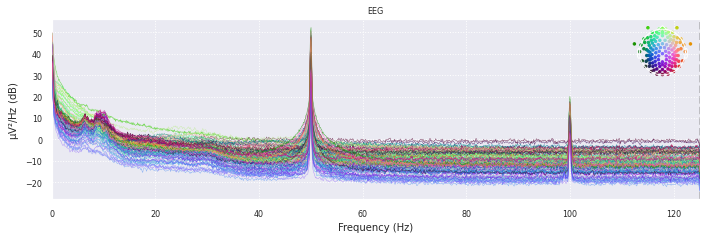

{'fear': (64407, 129039), 'sad': (293, 64212), 'happy': (129238, 195449)}
['sad', 'fear', 'happy']
64212
64407
129039
129238
Reading 0 ... 64632  =      0.000 ...   258.528 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66211  =      0.000 ...   264.844 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 63919  =      0.000 ...   255.676 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

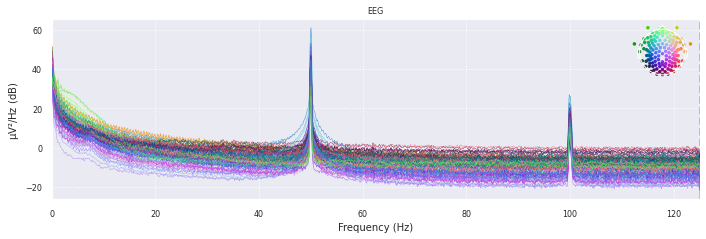

{'fear': (66552, 133392), 'sad': (317, 66344), 'happy': (133602, 200913)}
['sad', 'fear', 'happy']
66344
66552
133392
133602
Reading 0 ... 66840  =      0.000 ...   267.360 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 67311  =      0.000 ...   269.244 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66027  =      0.000 ...   264.108 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

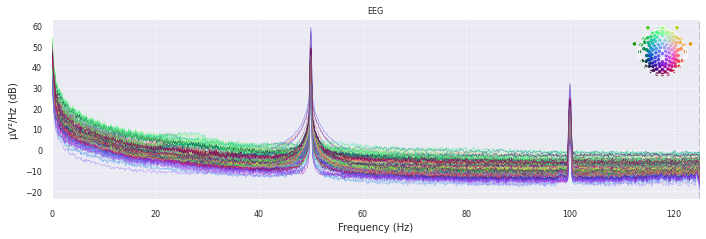

{'fear': (68167, 135157), 'sad': (296, 67982), 'happy': (135384, 201399)}
['sad', 'fear', 'happy']
67982
68167
135157
135384
Reading 0 ... 66990  =      0.000 ...   267.960 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66015  =      0.000 ...   264.060 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67686  =      0.000 ...   270.744 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

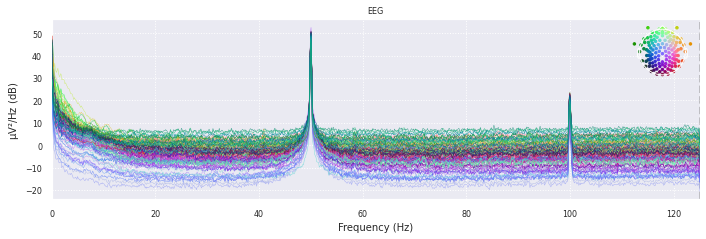

{'fear': (133023, 201455), 'sad': (299, 65897), 'happy': (66159, 132832)}
['sad', 'happy', 'fear']
65897
66159
132832
133023
Reading 0 ... 68432  =      0.000 ...   273.728 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66673  =      0.000 ...   266.692 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65598  =      0.000 ...   262.392 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

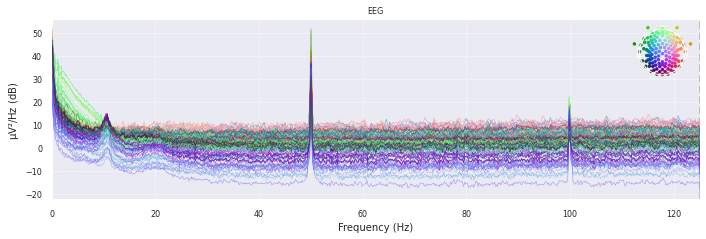

{'fear': (296, 65728), 'sad': (131413, 197778), 'happy': (65941, 131214)}
['fear', 'happy', 'sad']
65728
65941
131214
131413
Reading 0 ... 65432  =      0.000 ...   261.728 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65273  =      0.000 ...   261.092 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66365  =      0.000 ...   265.460 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

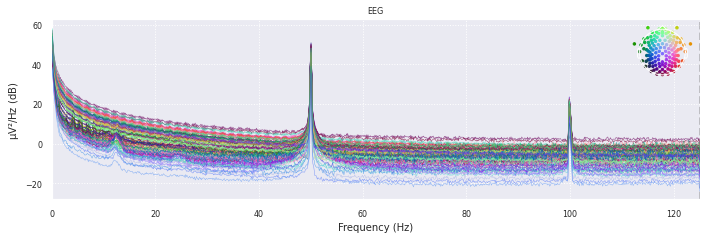

{'fear': (136274, 204035), 'sad': (69477, 136037), 'happy': (292, 69282)}
['happy', 'sad', 'fear']
69282
69477
136037
136274
Reading 0 ... 67761  =      0.000 ...   271.044 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68990  =      0.000 ...   275.960 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66560  =      0.000 ...   266.240 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

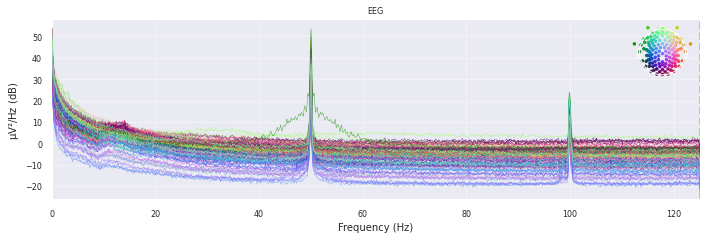

{'fear': (292, 65728), 'sad': (132375, 197632), 'happy': (65927, 132192)}
['fear', 'happy', 'sad']
65728
65927
132192
132375
Reading 0 ... 65436  =      0.000 ...   261.744 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66265  =      0.000 ...   265.060 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65257  =      0.000 ...   261.028 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

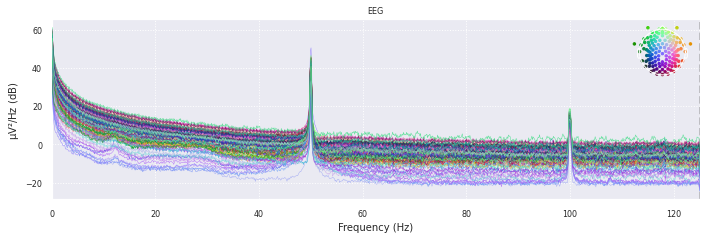

{'fear': (72112, 138218), 'sad': (293, 71883), 'happy': (138443, 206453)}
['sad', 'fear', 'happy']
71883
72112
138218
138443
Reading 0 ... 66106  =      0.000 ...   264.424 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 68010  =      0.000 ...   272.040 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 71590  =      0.000 ...   286.360 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

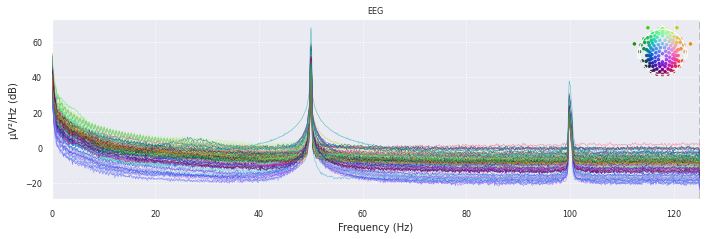

{'fear': (65276, 130457), 'sad': (302, 65063), 'happy': (130648, 195959)}
['sad', 'fear', 'happy']
65063
65276
130457
130648
Reading 0 ... 65181  =      0.000 ...   260.724 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65311  =      0.000 ...   261.244 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64761  =      0.000 ...   259.044 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

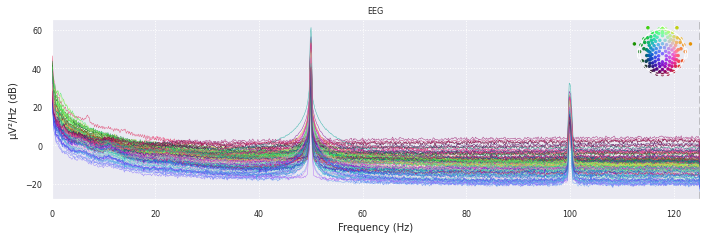

{'fear': (67463, 133519), 'sad': (133740, 200492), 'happy': (299, 67255)}
['happy', 'fear', 'sad']
67255
67463
133519
133740
Reading 0 ... 66056  =      0.000 ...   264.224 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 66956  =      0.000 ...   267.824 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66752  =      0.000 ...   267.008 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

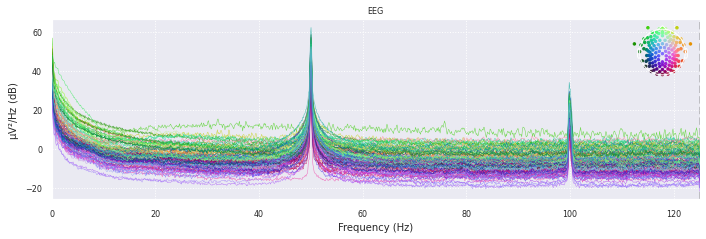

{'fear': (131952, 199134), 'sad': (65647, 131716), 'happy': (304, 65465)}
['happy', 'sad', 'fear']
65465
65647
131716
131952
Reading 0 ... 67182  =      0.000 ...   268.728 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 65161  =      0.000 ...   260.644 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66069  =      0.000 ...   264.276 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

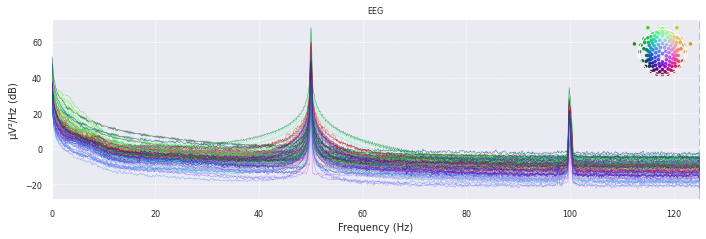

{'fear': (135798, 202521), 'sad': (68662, 135594), 'happy': (299, 68452)}
['happy', 'sad', 'fear']
68452
68662
135594
135798
Reading 0 ... 66723  =      0.000 ...   266.892 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68153  =      0.000 ...   272.612 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66932  =      0.000 ...   267.728 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

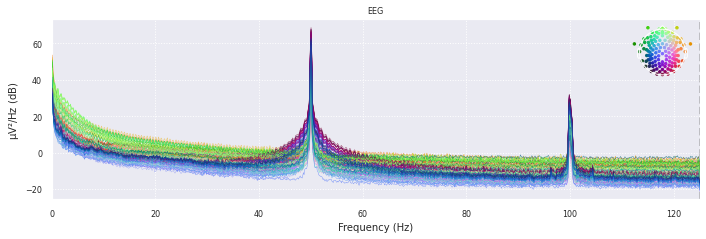

{'fear': (299, 65668), 'sad': (131540, 195876), 'happy': (65855, 131320)}
['fear', 'happy', 'sad']
65668
65855
131320
131540
Reading 0 ... 65369  =      0.000 ...   261.476 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 65465  =      0.000 ...   261.860 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64336  =      0.000 ...   257.344 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

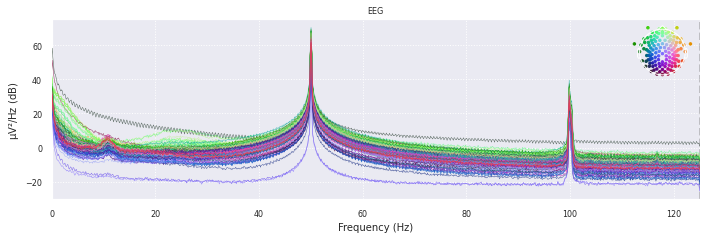

{'fear': (303, 68617), 'sad': (68825, 136590), 'happy': (136789, 204933)}
['fear', 'sad', 'happy']
68617
68825
136590
136789
Reading 0 ... 68314  =      0.000 ...   273.256 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 68144  =      0.000 ...   272.576 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67765  =      0.000 ...   271.060 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

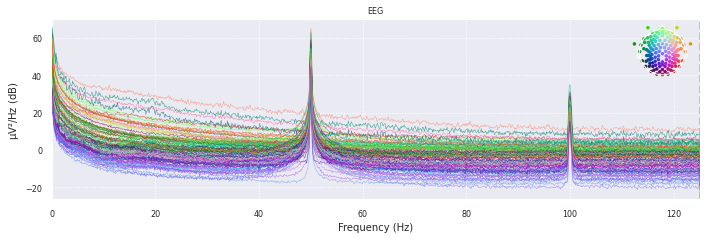

{'fear': (66382, 132110), 'sad': (293, 66179), 'happy': (132355, 198012)}
['sad', 'fear', 'happy']
66179
66382
132110
132355
Reading 0 ... 65728  =      0.000 ...   262.912 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 65657  =      0.000 ...   262.628 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65886  =      0.000 ...   263.544 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

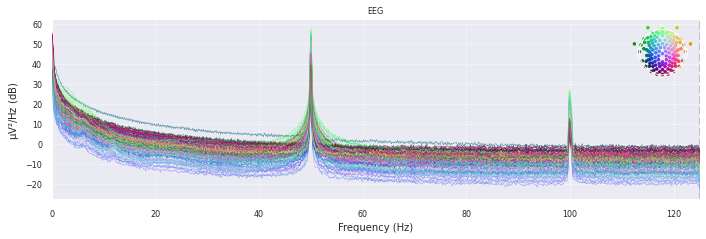

{'fear': (295, 66648), 'sad': (134230, 202445), 'happy': (66871, 134040)}
['fear', 'happy', 'sad']
66648
66871
134040
134230
Reading 0 ... 66353  =      0.000 ...   265.412 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67169  =      0.000 ...   268.676 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68215  =      0.000 ...   272.860 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

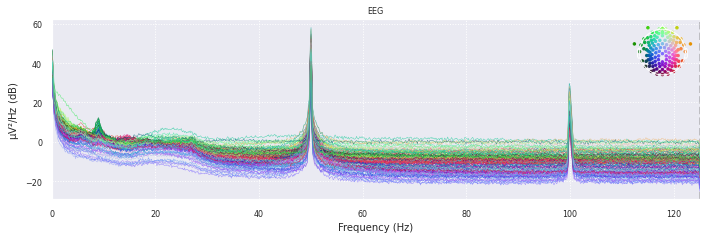

{'fear': (298, 69834), 'sad': (139098, 208091), 'happy': (70054, 138893)}
['fear', 'happy', 'sad']
69834
70054
138893
139098
Reading 0 ... 69536  =      0.000 ...   278.144 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 68839  =      0.000 ...   275.356 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 68993  =      0.000 ...   275.972 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

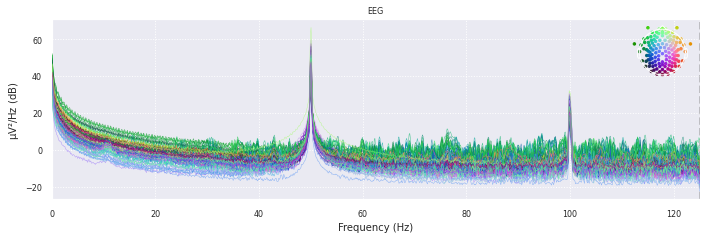

{'fear': (70946, 142669), 'sad': (142899, 211922), 'happy': (291, 70685)}
['happy', 'fear', 'sad']
70685
70946
142669
142899
Reading 0 ... 71723  =      0.000 ...   286.892 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 70394  =      0.000 ...   281.576 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 69023  =      0.000 ...   276.092 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

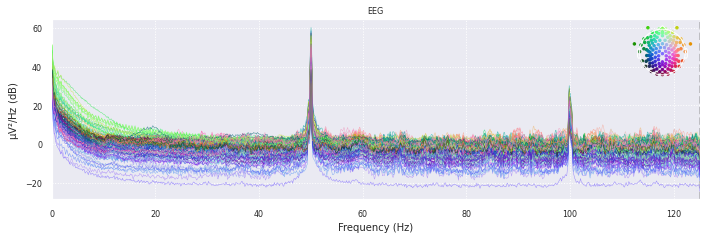

{'fear': (68065, 136596), 'sad': (136800, 204477), 'happy': (297, 67866)}
['happy', 'fear', 'sad']
67866
68065
136596
136800
Reading 0 ... 68531  =      0.000 ...   274.124 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 67569  =      0.000 ...   270.276 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67677  =      0.000 ...   270.708 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

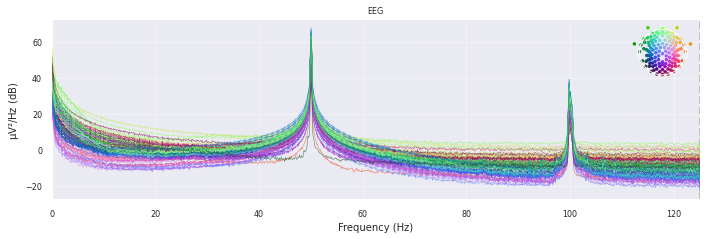

{'fear': (132227, 197784), 'sad': (66184, 132024), 'happy': (300, 65973)}
['happy', 'sad', 'fear']
65973
66184
132024
132227
Reading 0 ... 65557  =      0.000 ...   262.228 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65673  =      0.000 ...   262.692 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65840  =      0.000 ...   263.360 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

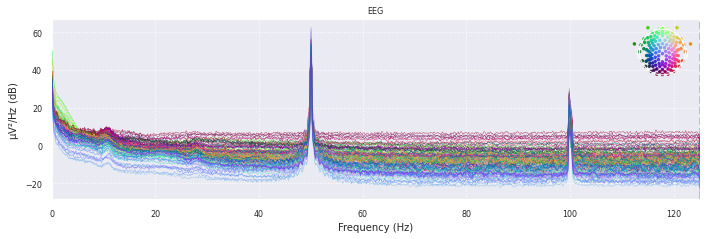

{'fear': (170002, 238579), 'sad': (300, 99688), 'happy': (100313, 169786)}
['sad', 'happy', 'fear']
99688
100313
169786
170002
Reading 0 ... 68577  =      0.000 ...   274.308 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 69473  =      0.000 ...   277.892 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 99388  =      0.000 ...   397.552 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

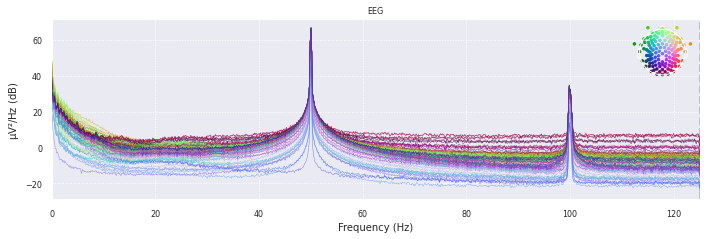

{'fear': (138674, 205638), 'sad': (71159, 138482), 'happy': (307, 70875)}
['happy', 'sad', 'fear']
70875
71159
138482
138674
Reading 0 ... 66964  =      0.000 ...   267.856 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 70568  =      0.000 ...   282.272 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67323  =      0.000 ...   269.292 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

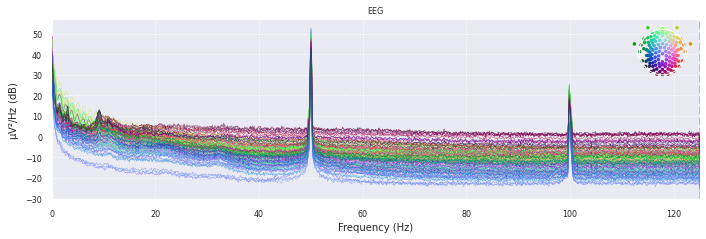

{'fear': (302, 65580), 'sad': (65771, 130669), 'happy': (130869, 195113)}
['fear', 'sad', 'happy']
65580
65771
130669
130869
Reading 0 ... 65278  =      0.000 ...   261.112 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 64244  =      0.000 ...   256.976 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64898  =      0.000 ...   259.592 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

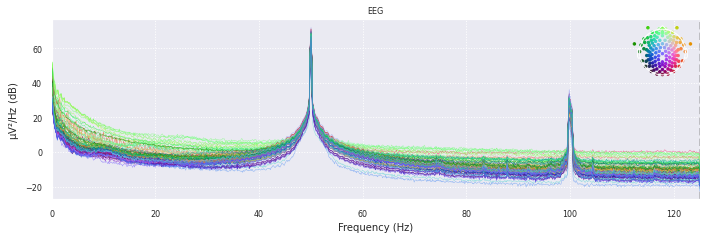

{'fear': (298, 66255), 'sad': (66438, 133148), 'happy': (133393, 200604)}
['fear', 'sad', 'happy']
66255
66438
133148
133393
Reading 0 ... 65957  =      0.000 ...   263.828 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 67211  =      0.000 ...   268.844 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 66710  =      0.000 ...   266.840 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

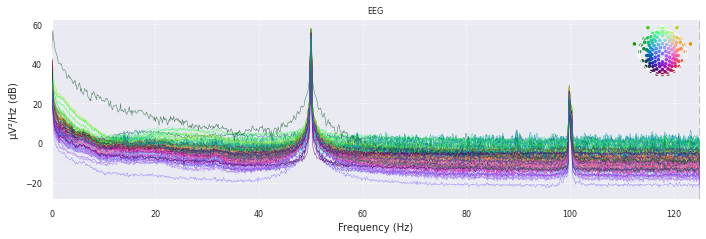

{'fear': (69802, 137454), 'sad': (300, 69569), 'happy': (137641, 205039)}
['sad', 'fear', 'happy']
69569
69802
137454
137641
Reading 0 ... 67652  =      0.000 ...   270.608 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 67398  =      0.000 ...   269.592 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 69269  =      0.000 ...   277.076 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

Infinite value in PSD for channel E114.
These channels might be dead.


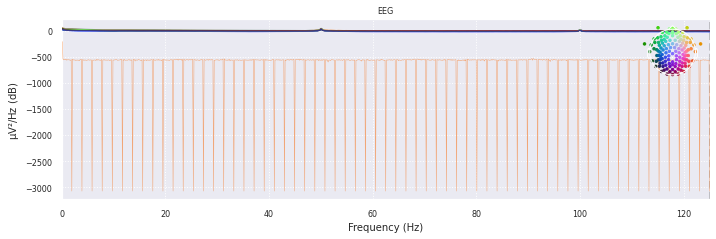

{'fear': (310, 75024), 'sad': (75269, 196132), 'happy': (196763, 289252)}
['fear', 'sad', 'happy']
75024
75269
196132
196763
Reading 0 ... 74714  =      0.000 ...   298.856 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 92489  =      0.000 ...   369.956 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 120863  =      0.000 ...   483.452 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower p

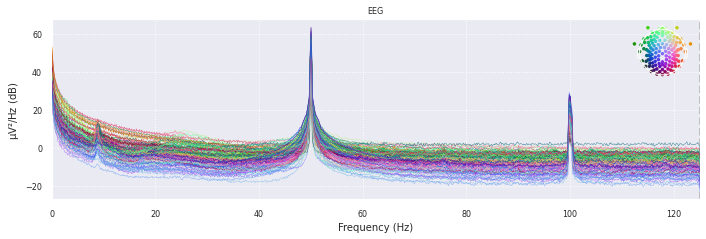

{'fear': (86799, 177430), 'sad': (177695, 264388), 'happy': (298, 86495)}
['happy', 'fear', 'sad']
86495
86799
177430
177695
Reading 0 ... 90631  =      0.000 ...   362.524 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 86197  =      0.000 ...   344.788 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 86693  =      0.000 ...   346.772 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

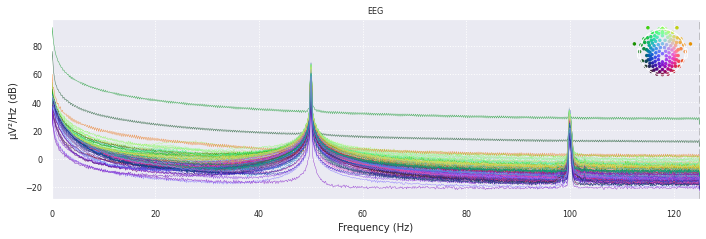

{'fear': (66212, 131531), 'sad': (131760, 197424), 'happy': (298, 65996)}
['happy', 'fear', 'sad']
65996
66212
131531
131760
Reading 0 ... 65319  =      0.000 ...   261.276 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



invalid value encountered in true_divide
invalid value encountered in true_divide


Reading 0 ... 65698  =      0.000 ...   262.792 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65664  =      0.000 ...   262.656 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower pa

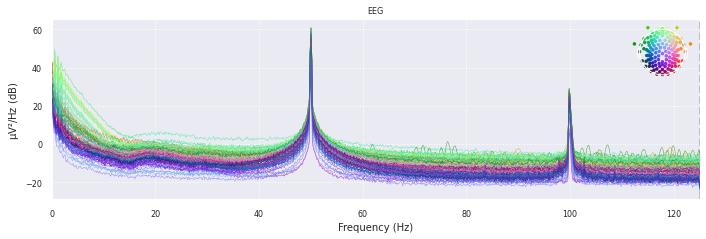

{'fear': (65417, 129286), 'sad': (129472, 194829), 'happy': (302, 65221)}
['happy', 'fear', 'sad']
65221
65417
129286
129472
Reading 0 ... 63869  =      0.000 ...   255.476 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 64919  =      0.000 ...   259.676 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65357  =      0.000 ...   261.428 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

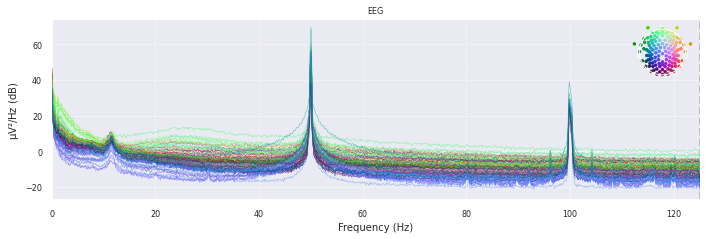

{'fear': (292, 65215), 'sad': (131520, 197206), 'happy': (65414, 130892)}
['fear', 'happy', 'sad']
65215
65414
130892
131520
Reading 0 ... 64923  =      0.000 ...   259.692 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65478  =      0.000 ...   261.912 secs...


invalid value encountered in true_divide
invalid value encountered in true_divide


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

Reading 0 ... 65686  =      0.000 ...   262.744 secs...
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz 

In [ ]:
final_patient_df = pd.DataFrame()

for root, dirs, files in os.walk("/content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015"):
  folder = "/content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015"
  for index, file in enumerate(files):
      if file[-3:]=='raw':
        print("File name ",file,"Position ",index)
        fin = str(folder)+"/"+str(file)
        df = file_importer(fin)
        fear,happy,sad = channel_explorer(df)
        lf_psd_params = pd.concat([signal_extractor(fear,'fear'),signal_extractor(happy,'happy'),signal_extractor(sad,'sad')],axis=1)
        nlf_psd_params = pd.concat([nli_features(fear,'fear'),nli_features(happy,'happy'),nli_features(sad,'sad')],axis = 1)
        result = pd.concat([lf_psd_params,nlf_psd_params],axis = 1)
        print(result.head())
        result = result[result.index.isin(list(Electrode_map.values()))]
        result_single_row = pd.DataFrame()
        for i in list(Electrode_map.values()):
          temp = pd.DataFrame(result[result.index == i].values)
          temp.columns = [j+'_'+i for j in result.columns]
          result_single_row = pd.concat([result_single_row,temp],axis = 1) 
        result_single_row['patient_identifier'] = file
        final_patient_df = pd.concat([final_patient_df,result_single_row],axis = 0)
        del df

File name  02010002rest 20150416 1017..mat Position  0
Creating RawArray with float64 data, n_channels=128, n_times=75189
    Range : 0 ... 75188 =      0.000 ...   300.752 secs
Ready.
Effective window size : 8.192 (s)


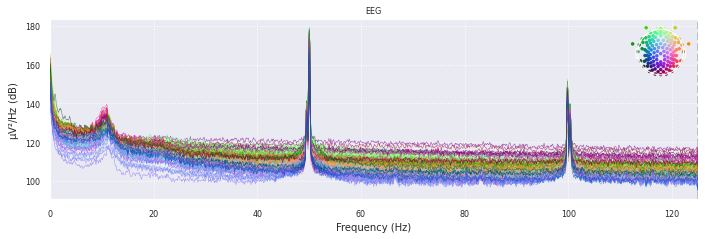

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010004rest 20150427 1335..mat Position  1
Creating RawArray with float64 data, n_channels=128, n_times=75339
    Range : 0 ... 75338 =      0.000 ...   301.352 secs
Ready.
Effective window size : 8.192 (s)


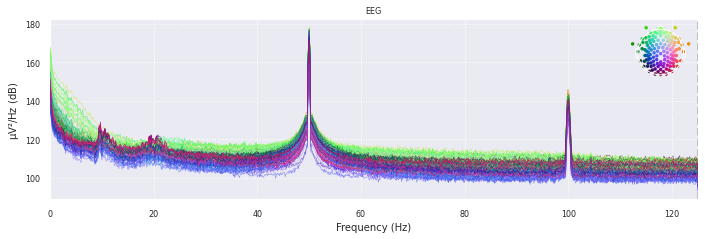

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010005rest 20150507 0907..mat Position  2
Creating RawArray with float64 data, n_channels=128, n_times=75226
    Range : 0 ... 75225 =      0.000 ...   300.900 secs
Ready.
Effective window size : 8.192 (s)


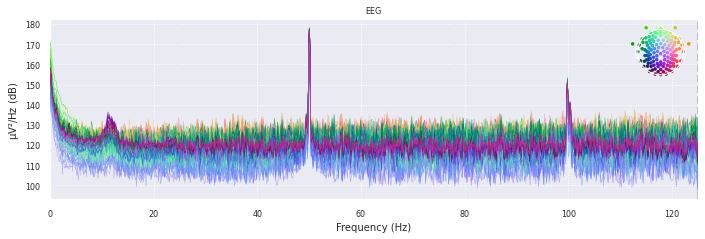

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010006rest 20150528 0928..mat Position  3
Creating RawArray with float64 data, n_channels=128, n_times=78639
    Range : 0 ... 78638 =      0.000 ...   314.552 secs
Ready.
Effective window size : 8.192 (s)


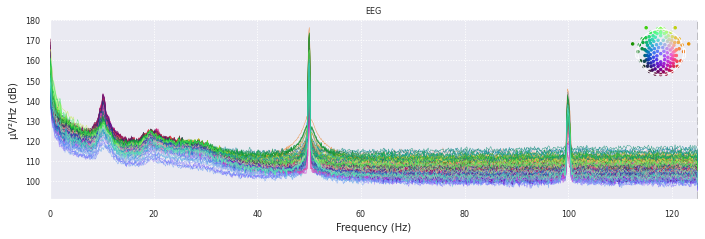

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010008_rest 20150619 1653.mat Position  4
Creating RawArray with float64 data, n_channels=128, n_times=82651
    Range : 0 ... 82650 =      0.000 ...   330.600 secs
Ready.
Effective window size : 8.192 (s)


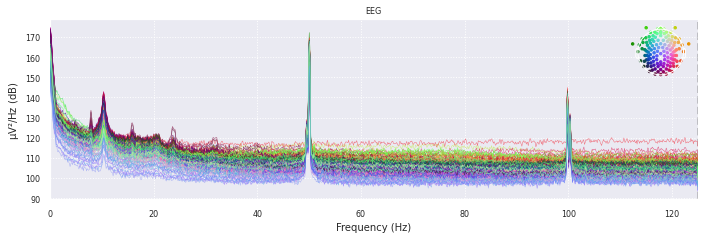

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010010rest 20150624 1447..mat Position  5
Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
Effective window size : 8.192 (s)


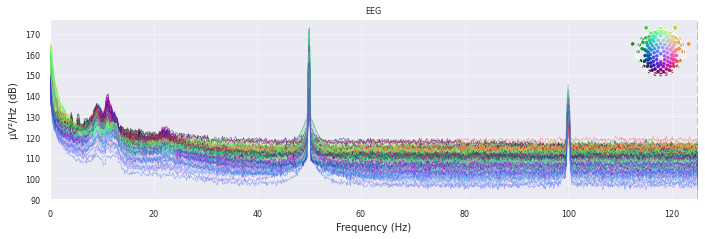

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010011rest 20150625 1516..mat Position  6
Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


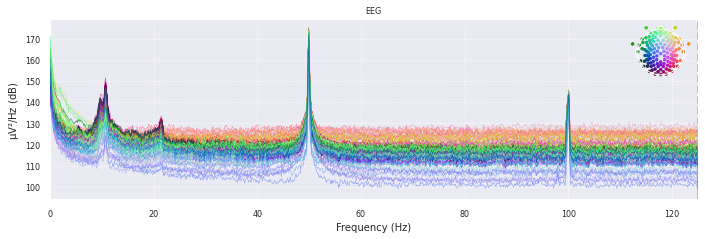

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010012rest 20150626 1026..mat Position  7
Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


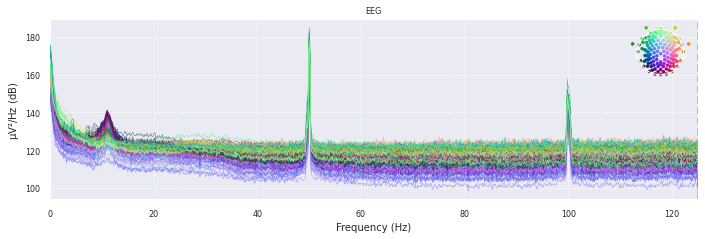

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010013rest 20150703 1333..mat Position  8
Creating RawArray with float64 data, n_channels=128, n_times=75176
    Range : 0 ... 75175 =      0.000 ...   300.700 secs
Ready.
Effective window size : 8.192 (s)


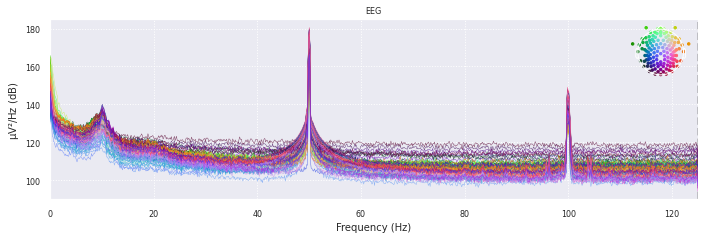

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010015rest 20150709 1456..mat Position  9
Creating RawArray with float64 data, n_channels=128, n_times=75652
    Range : 0 ... 75651 =      0.000 ...   302.604 secs
Ready.
Effective window size : 8.192 (s)


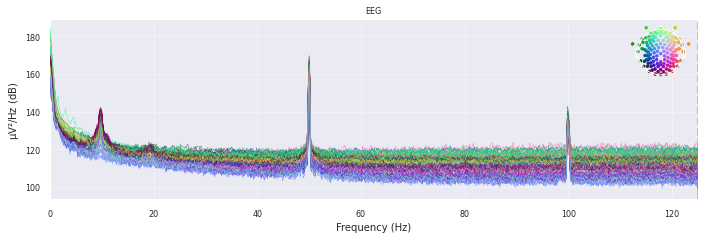

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010016rest 20150710 1220..mat Position  10
Creating RawArray with float64 data, n_channels=128, n_times=75201
    Range : 0 ... 75200 =      0.000 ...   300.800 secs
Ready.
Effective window size : 8.192 (s)


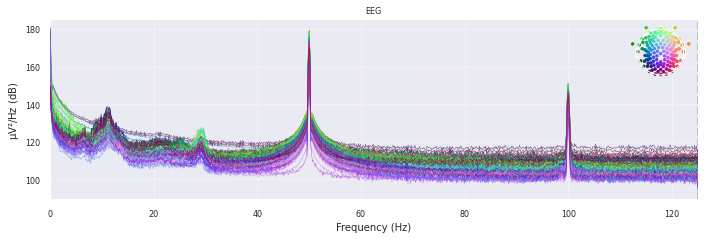

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010018rest 20150716 1237..mat Position  11
Creating RawArray with float64 data, n_channels=128, n_times=75351
    Range : 0 ... 75350 =      0.000 ...   301.400 secs
Ready.
Effective window size : 8.192 (s)


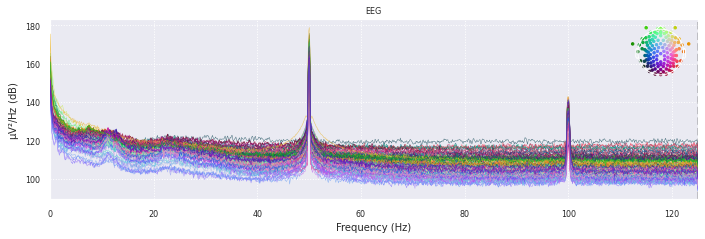

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010019rest 20150716 1440..mat Position  12
Creating RawArray with float64 data, n_channels=128, n_times=75401
    Range : 0 ... 75400 =      0.000 ...   301.600 secs
Ready.
Effective window size : 8.192 (s)


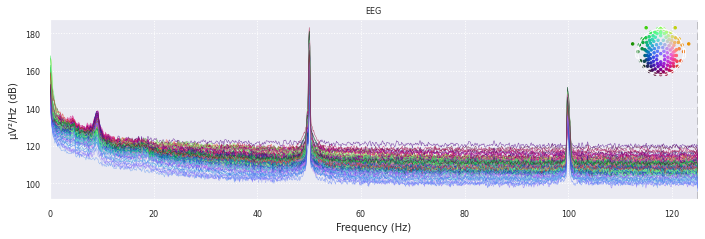

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010021 20150805 1730.mat.mat Position  13
Creating RawArray with float64 data, n_channels=128, n_times=75127
    Range : 0 ... 75126 =      0.000 ...   300.504 secs
Ready.
Effective window size : 8.192 (s)


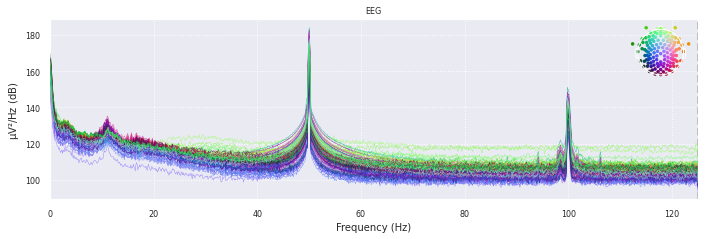

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010022restnew 20150724 14.mat Position  14
Creating RawArray with float64 data, n_channels=128, n_times=75276
    Range : 0 ... 75275 =      0.000 ...   301.100 secs
Ready.
Effective window size : 8.192 (s)


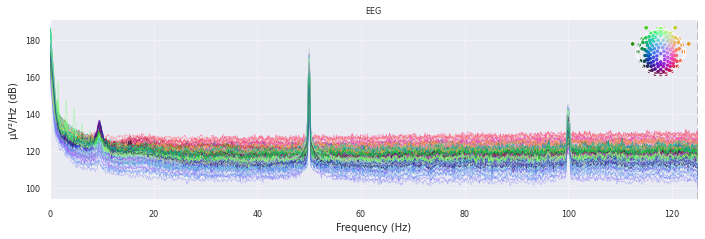

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010023rest 20150729 1929..mat Position  15
Creating RawArray with float64 data, n_channels=128, n_times=75089
    Range : 0 ... 75088 =      0.000 ...   300.352 secs
Ready.
Effective window size : 8.192 (s)


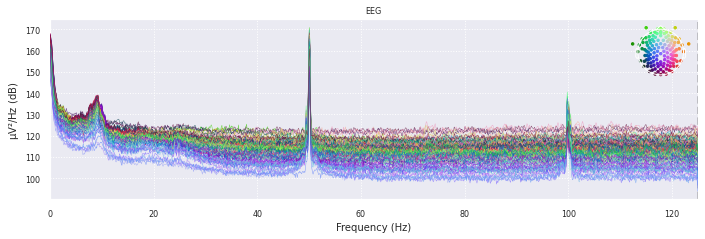

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010024rest 20150814 1504..mat Position  16
Creating RawArray with float64 data, n_channels=128, n_times=75389
    Range : 0 ... 75388 =      0.000 ...   301.552 secs
Ready.
Effective window size : 8.192 (s)


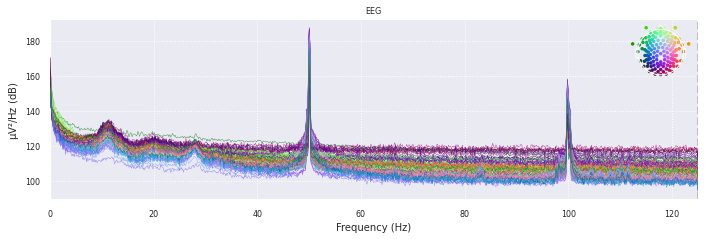

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010025 20160311 1206.mat.mat Position  17
Creating RawArray with float64 data, n_channels=128, n_times=75176
    Range : 0 ... 75175 =      0.000 ...   300.700 secs
Ready.
Effective window size : 8.192 (s)


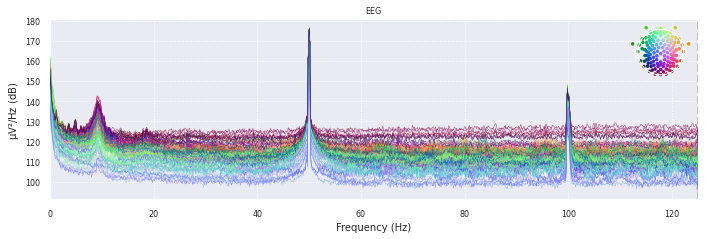

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010026rest 20160311 1421..mat Position  18
Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


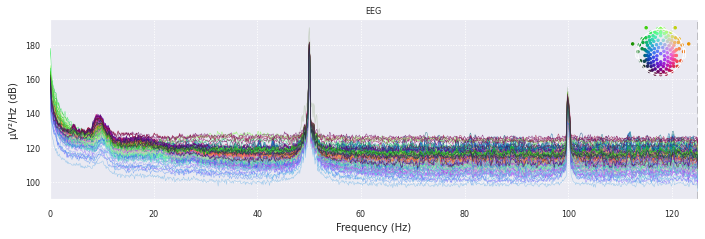

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010028rest 20160317 1538..mat Position  19
Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
Effective window size : 8.192 (s)


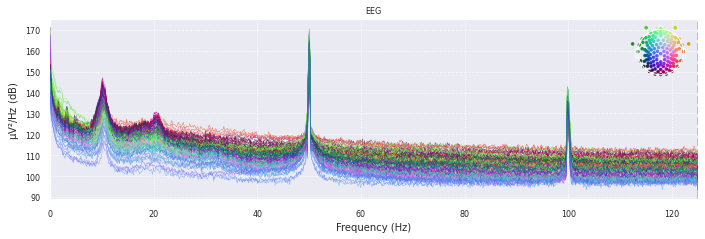

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010033rest 20160331 1239..mat Position  20
Creating RawArray with float64 data, n_channels=128, n_times=75289
    Range : 0 ... 75288 =      0.000 ...   301.152 secs
Ready.
Effective window size : 8.192 (s)


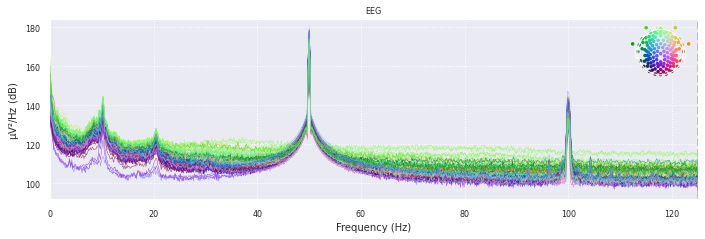

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010030rest 20160324 1054..mat Position  21
Creating RawArray with float64 data, n_channels=128, n_times=75402
    Range : 0 ... 75401 =      0.000 ...   301.604 secs
Ready.
Effective window size : 8.192 (s)


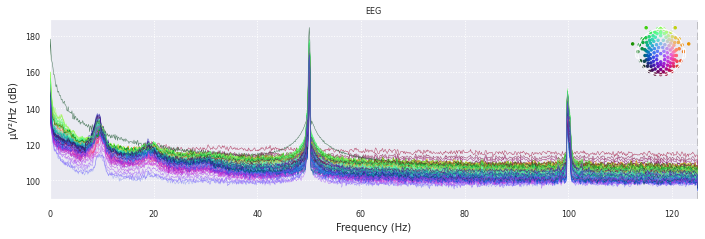

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010034rest 20160407 0938..mat Position  22
Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
Effective window size : 8.192 (s)


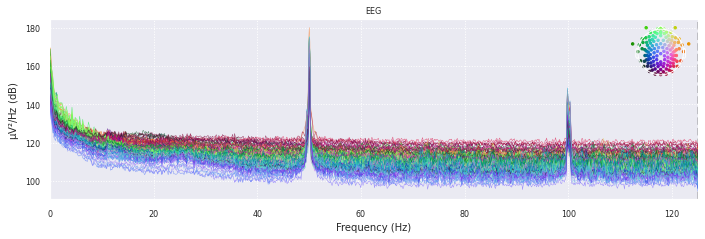

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02010036_rest 20160408 1418.mat Position  23
Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
Effective window size : 8.192 (s)


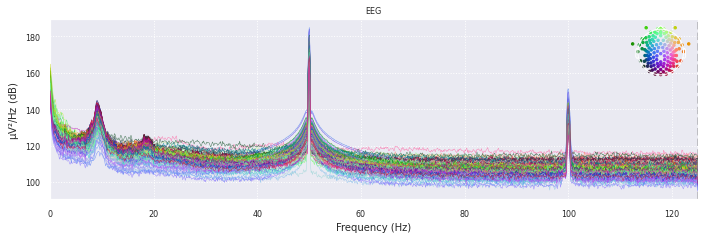

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020008rest 20150624 1711..mat Position  24
Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
Effective window size : 8.192 (s)


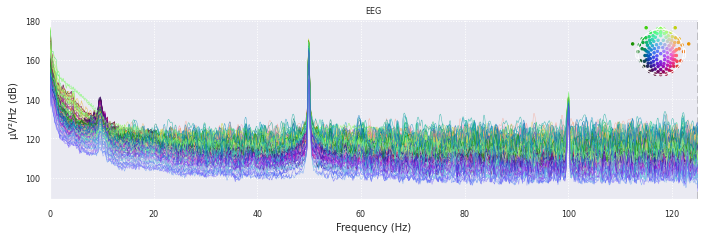

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020010rest 20150625 1224..mat Position  25
Creating RawArray with float64 data, n_channels=128, n_times=76039
    Range : 0 ... 76038 =      0.000 ...   304.152 secs
Ready.
Effective window size : 8.192 (s)


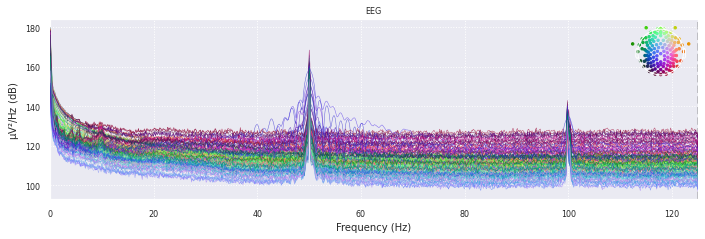

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020013rest 20150629 1607..mat Position  26
Creating RawArray with float64 data, n_channels=128, n_times=75251
    Range : 0 ... 75250 =      0.000 ...   301.000 secs
Ready.
Effective window size : 8.192 (s)


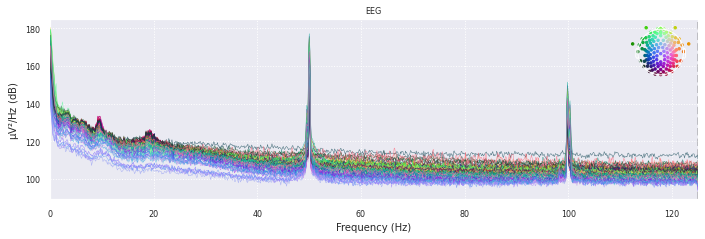

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020014_rest 20150630 1023.mat Position  27
Creating RawArray with float64 data, n_channels=128, n_times=75138
    Range : 0 ... 75137 =      0.000 ...   300.548 secs
Ready.
Effective window size : 8.192 (s)


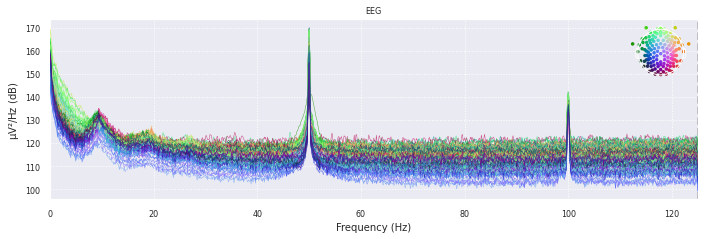

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020015_rest 20150630 1527.mat Position  28
Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
Effective window size : 8.192 (s)


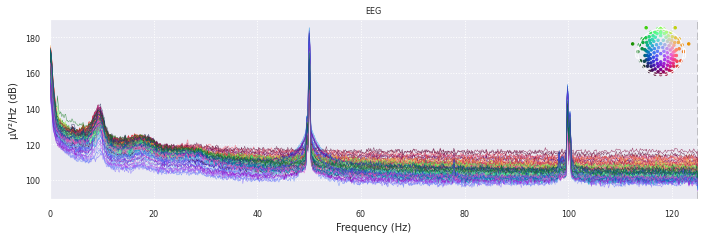

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020016rest 20150701 1040..mat Position  29
Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
Effective window size : 8.192 (s)


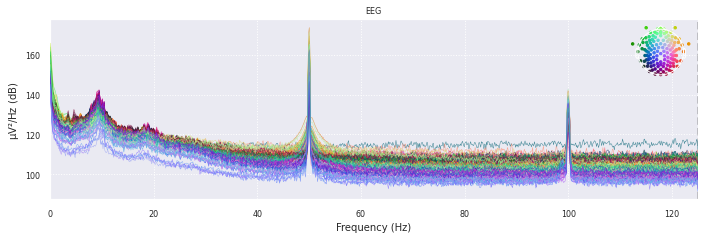

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020018rest 20150702 1651..mat Position  30
Creating RawArray with float64 data, n_channels=128, n_times=75189
    Range : 0 ... 75188 =      0.000 ...   300.752 secs
Ready.
Effective window size : 8.192 (s)


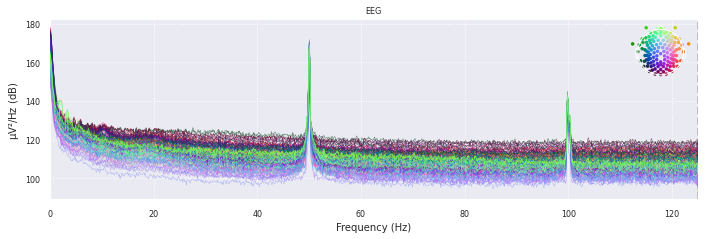

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020019rest 20150703 1036..mat Position  31
Creating RawArray with float64 data, n_channels=128, n_times=75163
    Range : 0 ... 75162 =      0.000 ...   300.648 secs
Ready.
Effective window size : 8.192 (s)


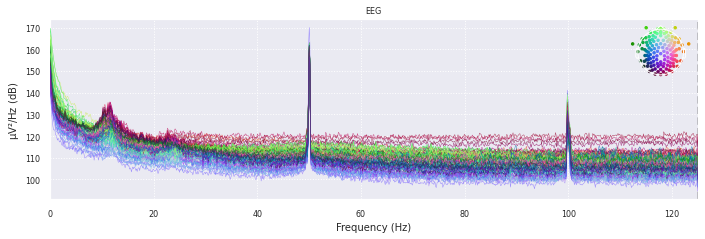

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020020rest 20150703 1754..mat Position  32
Creating RawArray with float64 data, n_channels=128, n_times=75376
    Range : 0 ... 75375 =      0.000 ...   301.500 secs
Ready.
Effective window size : 8.192 (s)


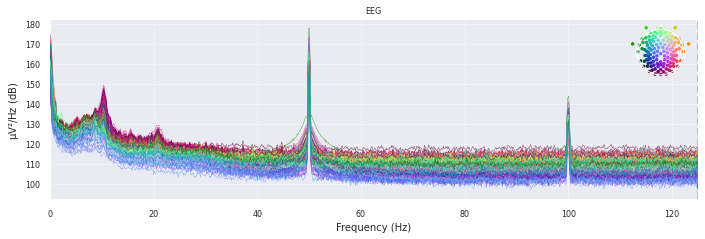

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020021rest 20150707 1720..mat Position  33
Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


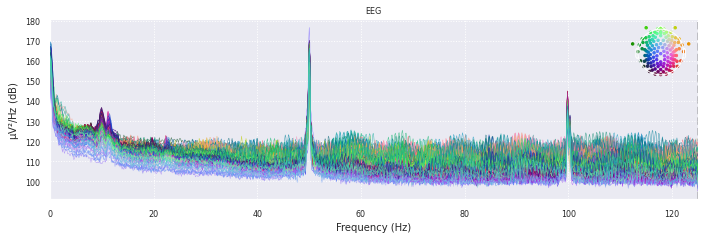

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020023restnew 20150709 10.mat Position  34
Creating RawArray with float64 data, n_channels=128, n_times=75201
    Range : 0 ... 75200 =      0.000 ...   300.800 secs
Ready.
Effective window size : 8.192 (s)


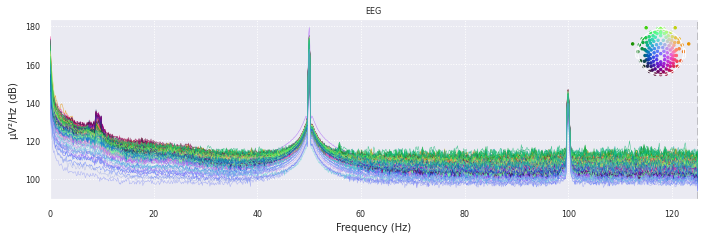

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020022rest 20150707 1452..mat Position  35
Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
Effective window size : 8.192 (s)


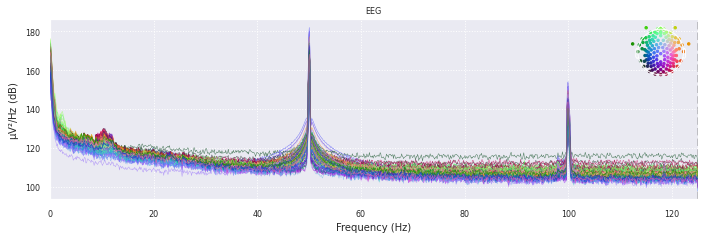

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020025rest 20150713 1519..mat Position  36
Creating RawArray with float64 data, n_channels=128, n_times=83876
    Range : 0 ... 83875 =      0.000 ...   335.500 secs
Ready.
Effective window size : 8.192 (s)


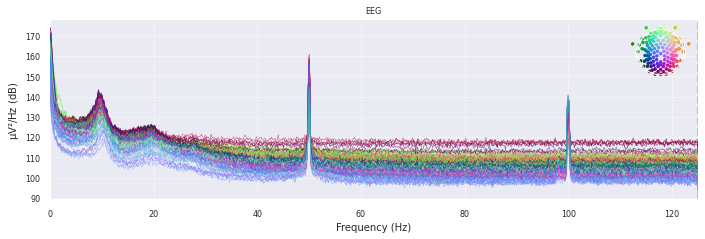

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020026_rest 20150714 1413.mat Position  37
Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
Effective window size : 8.192 (s)


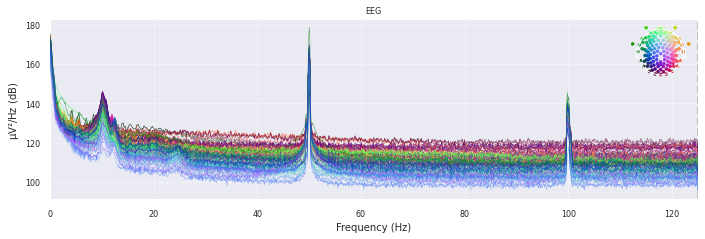

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020027rest 20150713 1049..mat Position  38
Creating RawArray with float64 data, n_channels=128, n_times=83164
    Range : 0 ... 83163 =      0.000 ...   332.652 secs
Ready.
Effective window size : 8.192 (s)


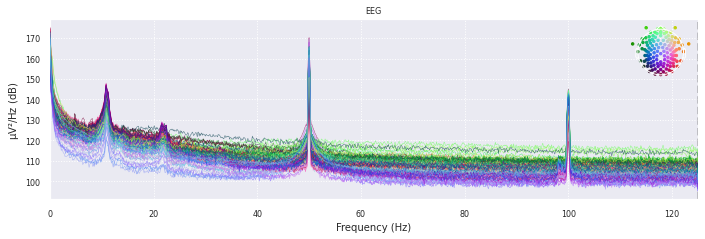

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02020029rest 20150715 1316..mat Position  39
Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
Effective window size : 8.192 (s)


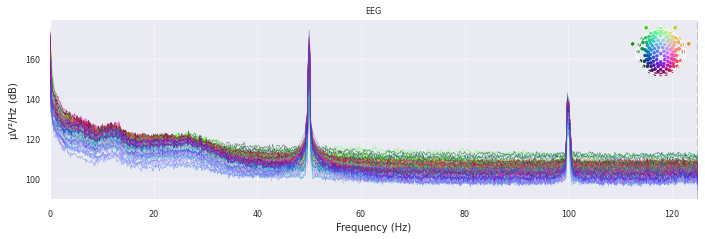

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030002rest_new 20151022 1.mat Position  40
Creating RawArray with float64 data, n_channels=128, n_times=75525
    Range : 0 ... 75524 =      0.000 ...   302.096 secs
Ready.
Effective window size : 8.192 (s)


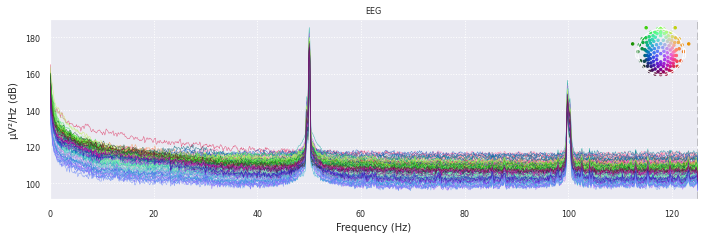

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030004_rest 20151026 1930.mat Position  41
Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
Effective window size : 8.192 (s)


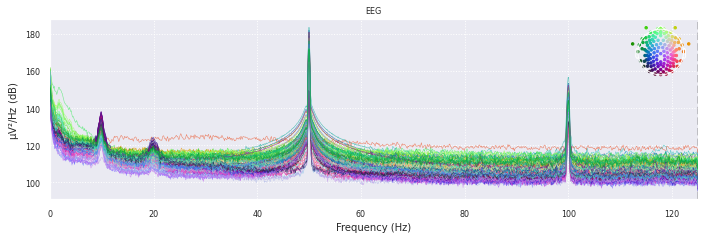

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030003_rest 20151022 1155.mat Position  42
Creating RawArray with float64 data, n_channels=128, n_times=75513
    Range : 0 ... 75512 =      0.000 ...   302.048 secs
Ready.
Effective window size : 8.192 (s)


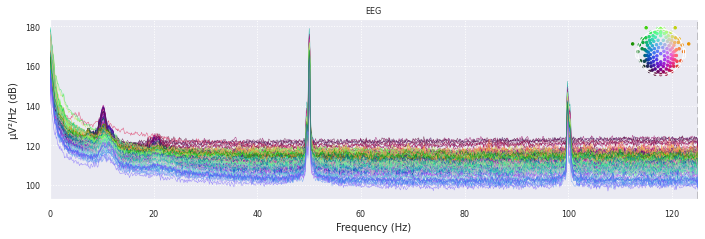

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030005rest 20151026 2103..mat Position  43
Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


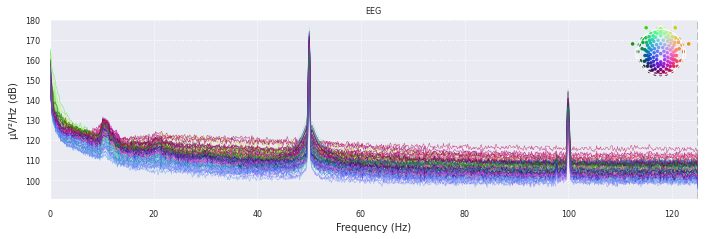

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030006_rest 20151103 1725.mat Position  44
Creating RawArray with float64 data, n_channels=128, n_times=75688
    Range : 0 ... 75687 =      0.000 ...   302.748 secs
Ready.
Effective window size : 8.192 (s)


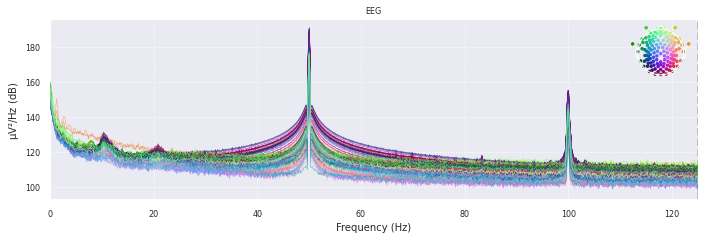

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030007_rest 20151103 2032.mat Position  45
Creating RawArray with float64 data, n_channels=128, n_times=75750
    Range : 0 ... 75749 =      0.000 ...   302.996 secs
Ready.
Effective window size : 8.192 (s)


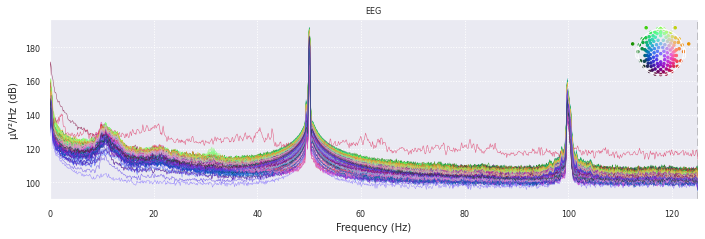

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030009_rest 20151105 1113.mat Position  46
Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
Effective window size : 8.192 (s)


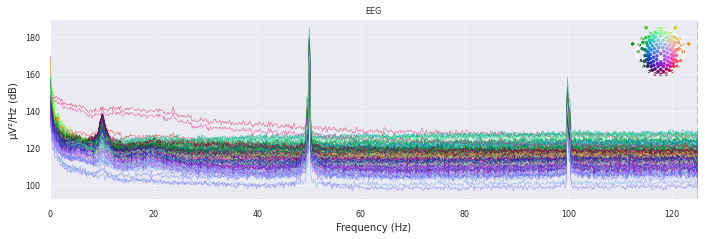

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030014rest 20151117 1441..mat Position  47
Creating RawArray with float64 data, n_channels=128, n_times=75188
    Range : 0 ... 75187 =      0.000 ...   300.748 secs
Ready.
Effective window size : 8.192 (s)


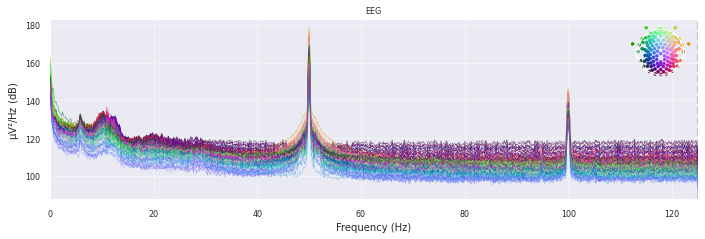

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030017_rest 20151208 1329.mat Position  48
Creating RawArray with float64 data, n_channels=128, n_times=75158
    Range : 0 ... 75157 =      0.000 ...   300.628 secs
Ready.
Effective window size : 8.192 (s)


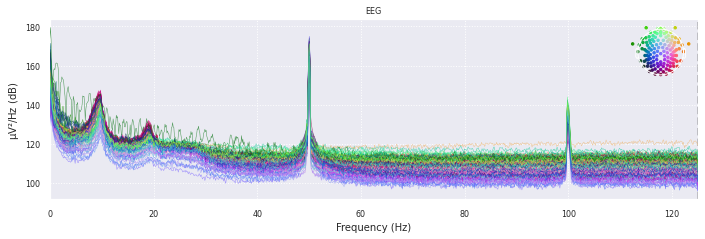

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030018_rest 20151208 1443.mat Position  49
Creating RawArray with float64 data, n_channels=128, n_times=75164
    Range : 0 ... 75163 =      0.000 ...   300.652 secs
Ready.
Effective window size : 8.192 (s)


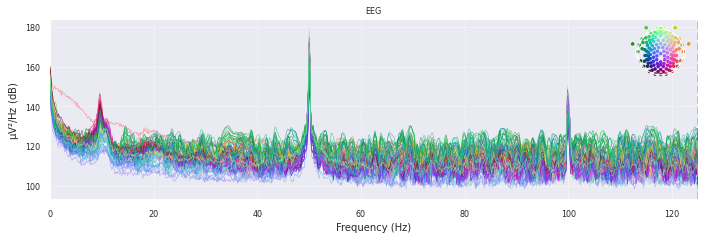

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030019_rest 20151230 1314.mat Position  50
Creating RawArray with float64 data, n_channels=128, n_times=75113
    Range : 0 ... 75112 =      0.000 ...   300.448 secs
Ready.
Effective window size : 8.192 (s)


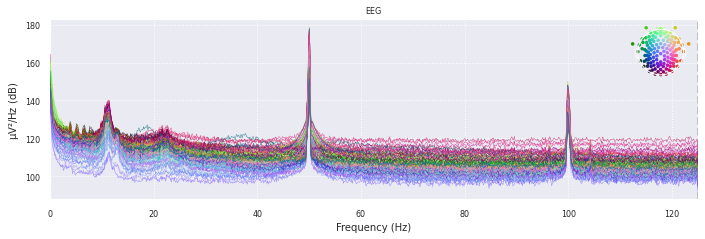

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030020_rest 20151230 1416.mat Position  51
Creating RawArray with float64 data, n_channels=128, n_times=75127
    Range : 0 ... 75126 =      0.000 ...   300.504 secs
Ready.
Effective window size : 8.192 (s)


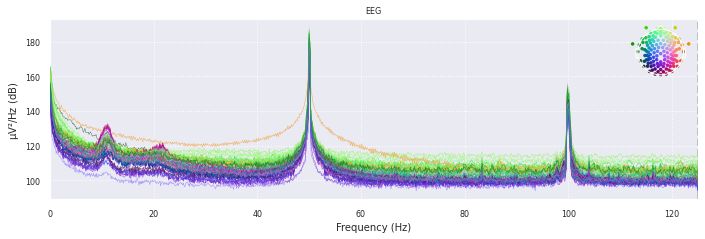

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)

File name  02030021rest 20160105 1141..mat Position  52
Creating RawArray with float64 data, n_channels=128, n_times=75275
    Range : 0 ... 75274 =      0.000 ...   301.096 secs
Ready.
Effective window size : 8.192 (s)


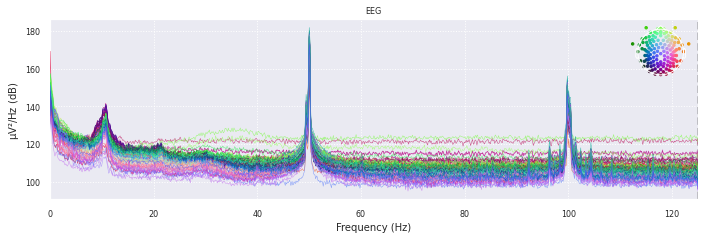

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 825 samples (3.300 sec)



In [ ]:
final_patient_resting = pd.DataFrame()

for root, dirs, files in os.walk("/content/drive/My Drive/dep_data/MODMA/EEG_128channels_resting_lanzhou_2015"):
  folder = "/content/drive/My Drive/dep_data/MODMA/EEG_128channels_resting_lanzhou_2015"
  for index, file in enumerate(files):
      if file[-3:]=='mat':
        print("File name ",file,"Position ",index)
        fin = str(folder)+"/"+str(file)
        df = file_importer(path=fin,type =0)
        lf_psd_params = signal_extractor(df,'resting')
        nlf_psd_params = nli_features(df,'resting')
        result = pd.concat([lf_psd_params,nlf_psd_params],axis = 1)
        result = result[result.index.isin(list(Electrode_map.values()))]
        result_single_row = pd.DataFrame()
        for i in list(Electrode_map.values()):
          temp = pd.DataFrame(result[result.index == i].values)
          temp.columns = [j+'_'+i for j in result.columns]
          result_single_row = pd.concat([result_single_row,temp],axis = 1) 
        result_single_row['patient_identifier'] = file
        final_patient_resting = pd.concat([final_patient_resting,result_single_row],axis = 0)
        del df

Creating RawArray with float64 data, n_channels=128, n_times=75189
    Range : 0 ... 75188 =      0.000 ...   300.752 secs
Ready.
Effective window size : 8.192 (s)


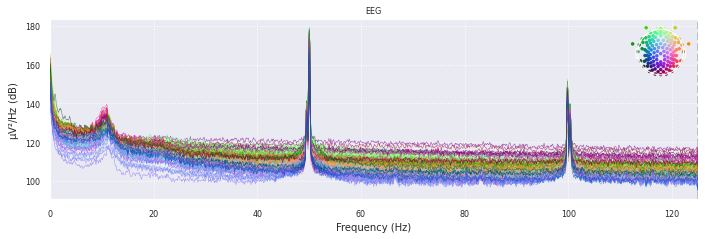

Creating RawArray with float64 data, n_channels=128, n_times=75339
    Range : 0 ... 75338 =      0.000 ...   301.352 secs
Ready.
Effective window size : 8.192 (s)


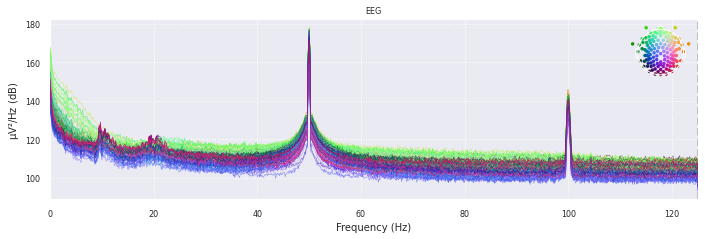

Creating RawArray with float64 data, n_channels=128, n_times=75226
    Range : 0 ... 75225 =      0.000 ...   300.900 secs
Ready.
Effective window size : 8.192 (s)


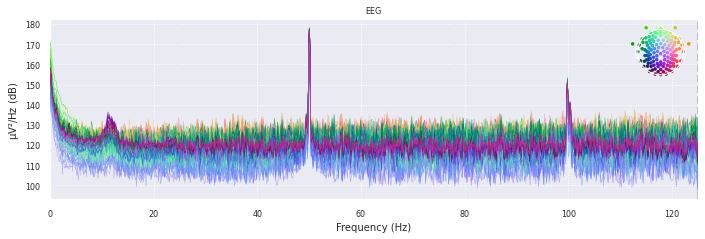

Creating RawArray with float64 data, n_channels=128, n_times=78639
    Range : 0 ... 78638 =      0.000 ...   314.552 secs
Ready.
Effective window size : 8.192 (s)


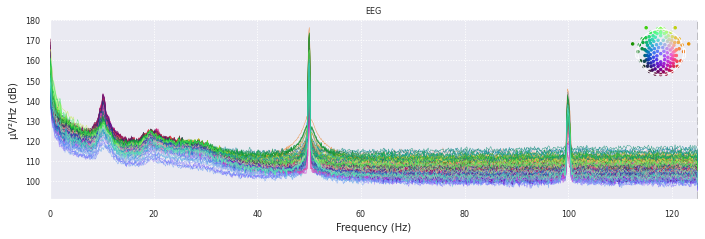

Creating RawArray with float64 data, n_channels=128, n_times=82651
    Range : 0 ... 82650 =      0.000 ...   330.600 secs
Ready.
Effective window size : 8.192 (s)


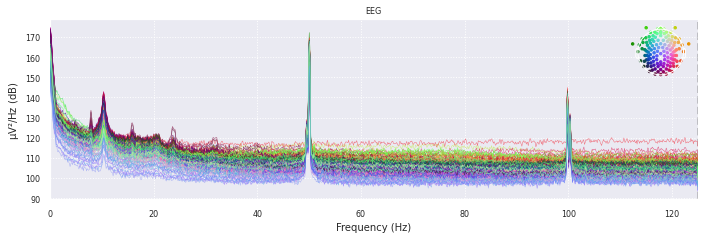

Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
Effective window size : 8.192 (s)


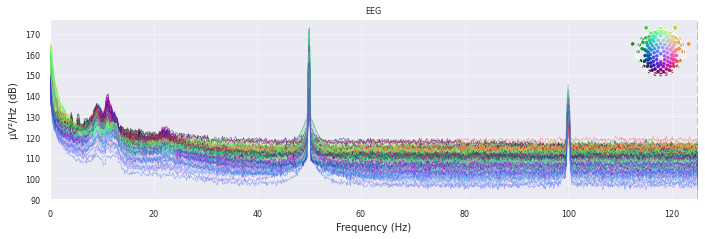

Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


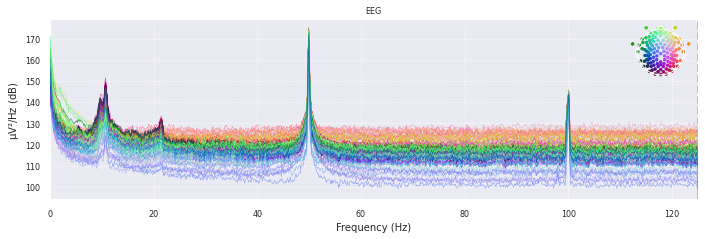

Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


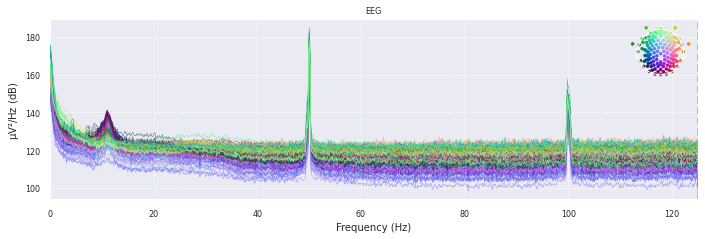

Creating RawArray with float64 data, n_channels=128, n_times=75176
    Range : 0 ... 75175 =      0.000 ...   300.700 secs
Ready.
Effective window size : 8.192 (s)


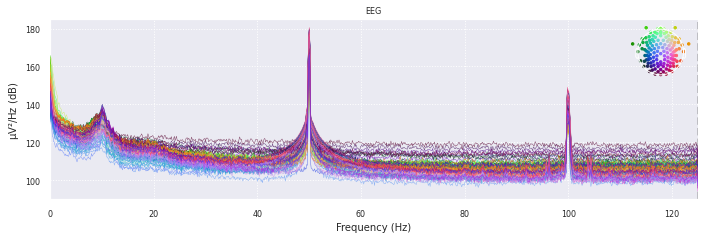

Creating RawArray with float64 data, n_channels=128, n_times=75652
    Range : 0 ... 75651 =      0.000 ...   302.604 secs
Ready.
Effective window size : 8.192 (s)


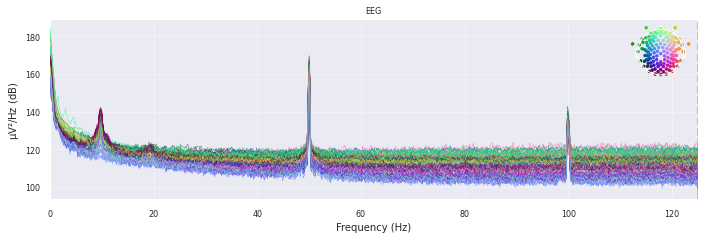

Creating RawArray with float64 data, n_channels=128, n_times=75201
    Range : 0 ... 75200 =      0.000 ...   300.800 secs
Ready.
Effective window size : 8.192 (s)


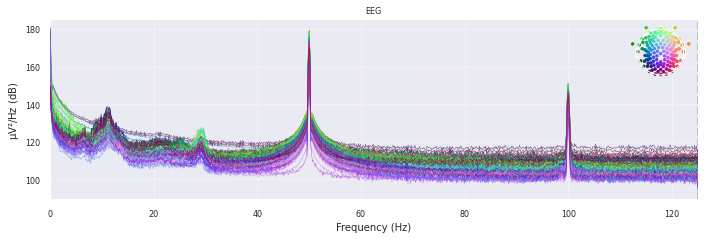

Creating RawArray with float64 data, n_channels=128, n_times=75351
    Range : 0 ... 75350 =      0.000 ...   301.400 secs
Ready.
Effective window size : 8.192 (s)


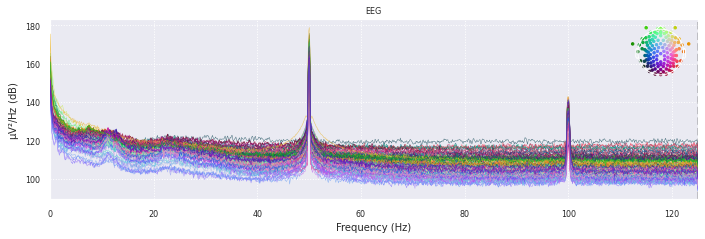

Creating RawArray with float64 data, n_channels=128, n_times=75401
    Range : 0 ... 75400 =      0.000 ...   301.600 secs
Ready.
Effective window size : 8.192 (s)


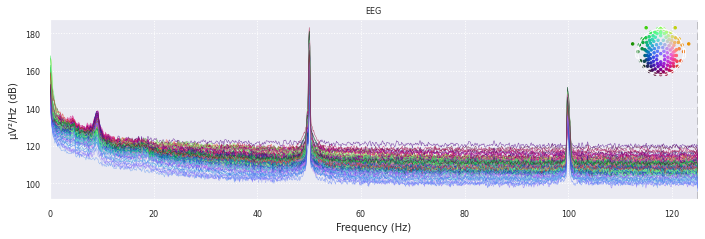

Creating RawArray with float64 data, n_channels=128, n_times=75127
    Range : 0 ... 75126 =      0.000 ...   300.504 secs
Ready.
Effective window size : 8.192 (s)


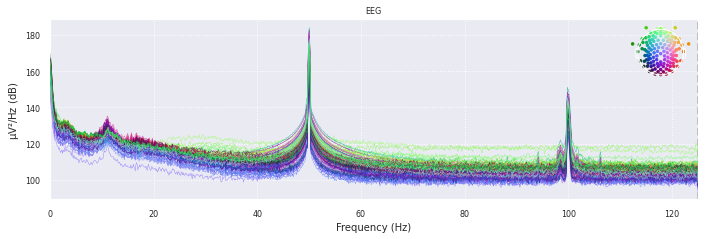

Creating RawArray with float64 data, n_channels=128, n_times=75276
    Range : 0 ... 75275 =      0.000 ...   301.100 secs
Ready.
Effective window size : 8.192 (s)


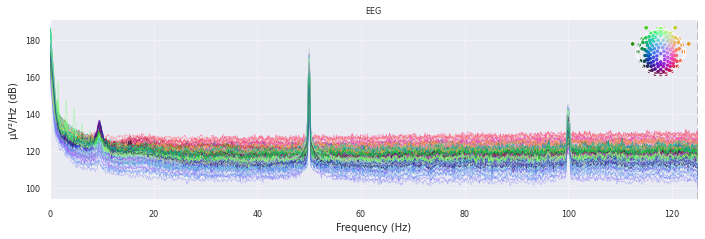

Creating RawArray with float64 data, n_channels=128, n_times=75089
    Range : 0 ... 75088 =      0.000 ...   300.352 secs
Ready.
Effective window size : 8.192 (s)


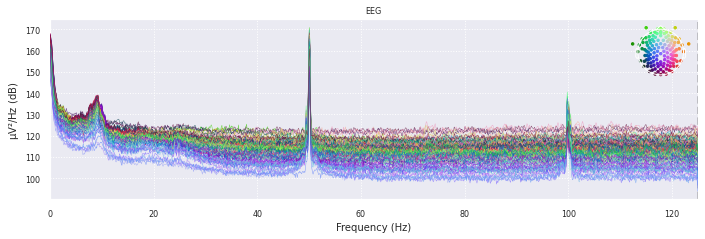

Creating RawArray with float64 data, n_channels=128, n_times=75389
    Range : 0 ... 75388 =      0.000 ...   301.552 secs
Ready.
Effective window size : 8.192 (s)


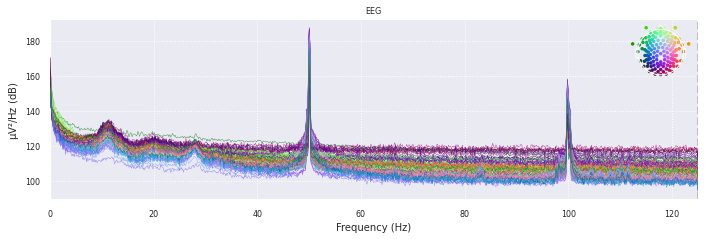

Creating RawArray with float64 data, n_channels=128, n_times=75176
    Range : 0 ... 75175 =      0.000 ...   300.700 secs
Ready.
Effective window size : 8.192 (s)


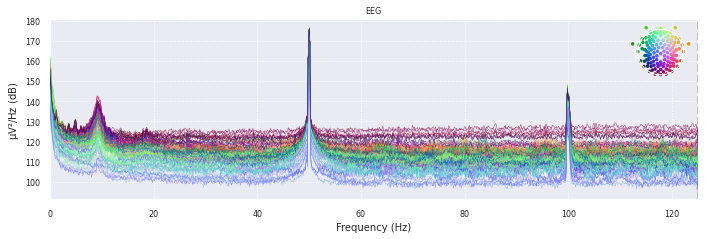

Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


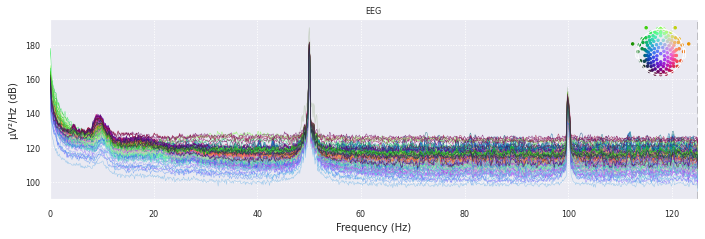

Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
Effective window size : 8.192 (s)


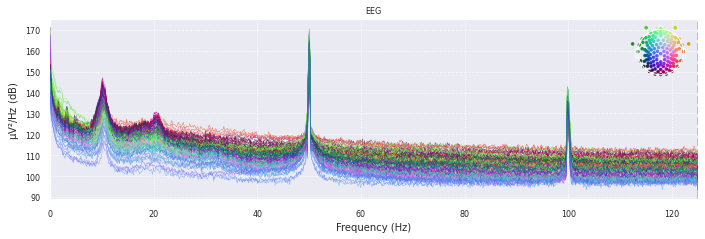

Creating RawArray with float64 data, n_channels=128, n_times=75289
    Range : 0 ... 75288 =      0.000 ...   301.152 secs
Ready.
Effective window size : 8.192 (s)


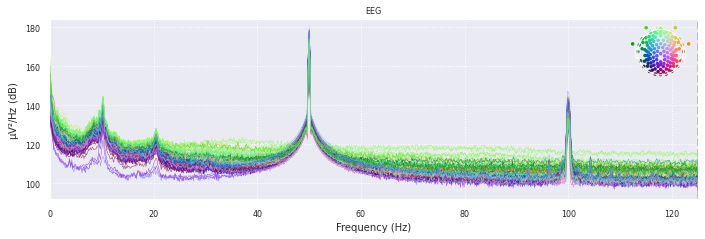

Creating RawArray with float64 data, n_channels=128, n_times=75402
    Range : 0 ... 75401 =      0.000 ...   301.604 secs
Ready.
Effective window size : 8.192 (s)


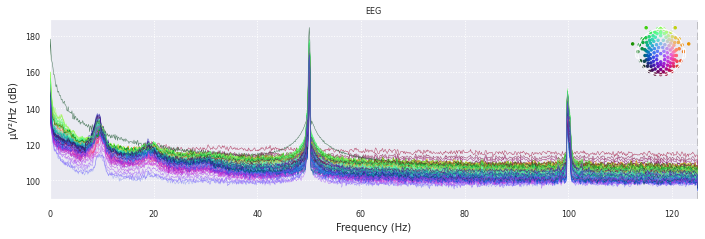

Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
Effective window size : 8.192 (s)


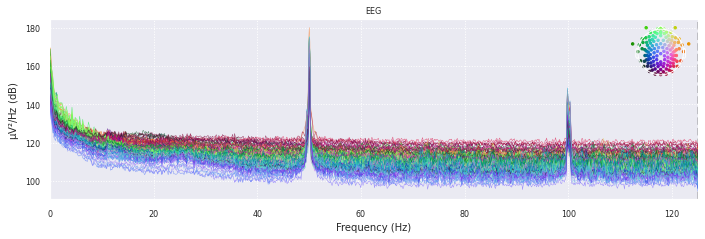

Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
Effective window size : 8.192 (s)


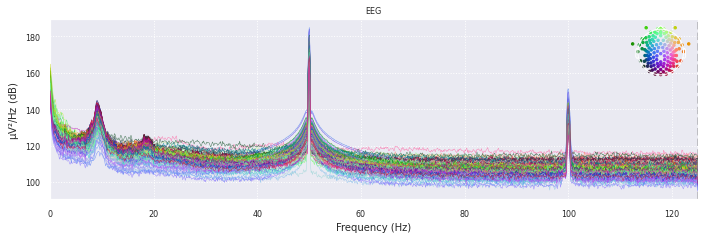

Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
Effective window size : 8.192 (s)


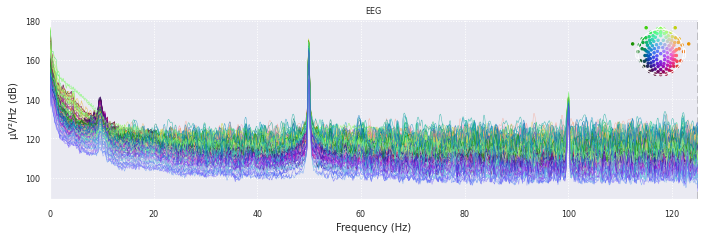

Creating RawArray with float64 data, n_channels=128, n_times=76039
    Range : 0 ... 76038 =      0.000 ...   304.152 secs
Ready.
Effective window size : 8.192 (s)


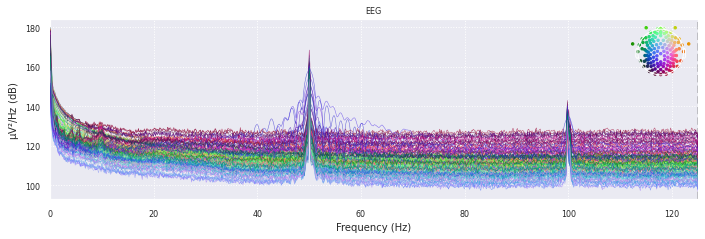

Creating RawArray with float64 data, n_channels=128, n_times=75251
    Range : 0 ... 75250 =      0.000 ...   301.000 secs
Ready.
Effective window size : 8.192 (s)


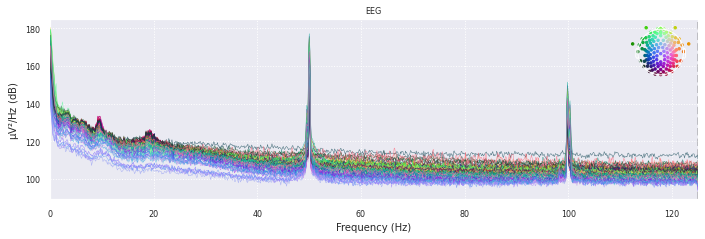

Creating RawArray with float64 data, n_channels=128, n_times=75138
    Range : 0 ... 75137 =      0.000 ...   300.548 secs
Ready.
Effective window size : 8.192 (s)


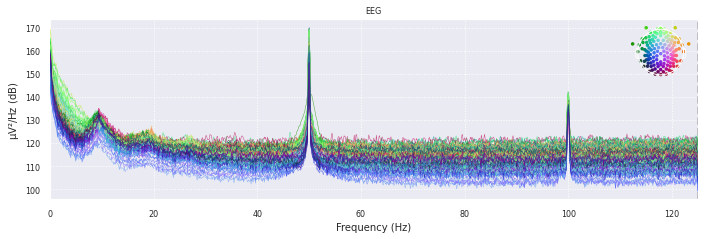

Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
Effective window size : 8.192 (s)


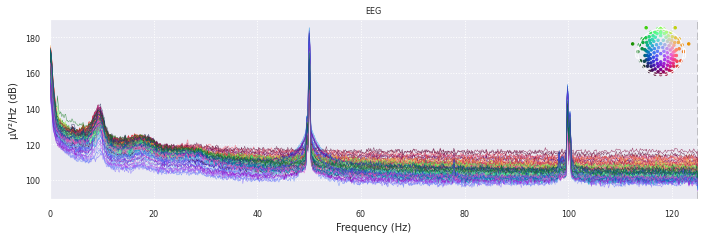

Creating RawArray with float64 data, n_channels=128, n_times=75101
    Range : 0 ... 75100 =      0.000 ...   300.400 secs
Ready.
Effective window size : 8.192 (s)


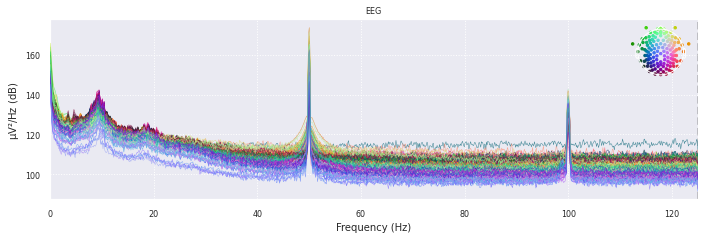

Creating RawArray with float64 data, n_channels=128, n_times=75189
    Range : 0 ... 75188 =      0.000 ...   300.752 secs
Ready.
Effective window size : 8.192 (s)


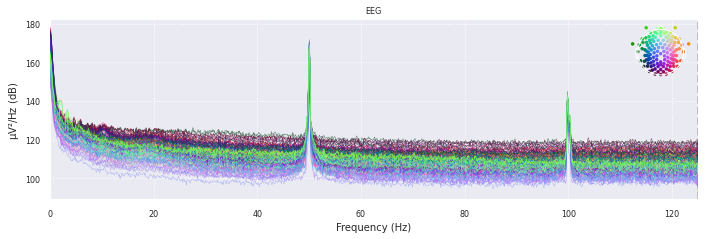

Creating RawArray with float64 data, n_channels=128, n_times=75163
    Range : 0 ... 75162 =      0.000 ...   300.648 secs
Ready.
Effective window size : 8.192 (s)


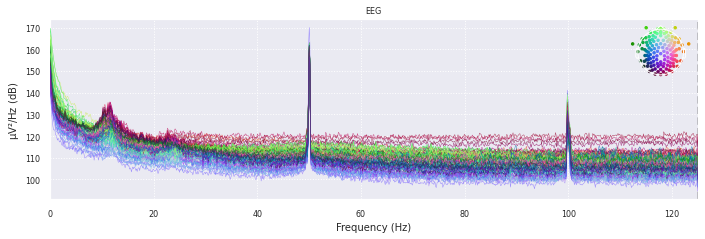

Creating RawArray with float64 data, n_channels=128, n_times=75376
    Range : 0 ... 75375 =      0.000 ...   301.500 secs
Ready.
Effective window size : 8.192 (s)


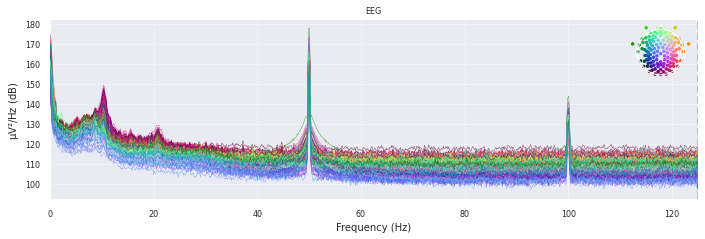

Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


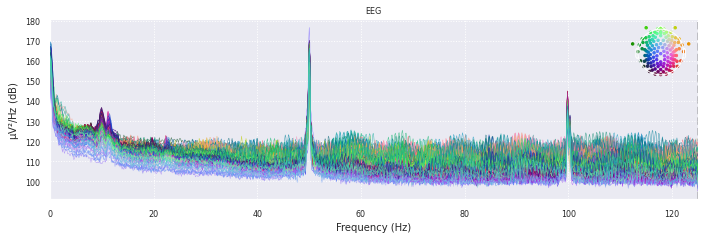

Creating RawArray with float64 data, n_channels=128, n_times=75201
    Range : 0 ... 75200 =      0.000 ...   300.800 secs
Ready.
Effective window size : 8.192 (s)


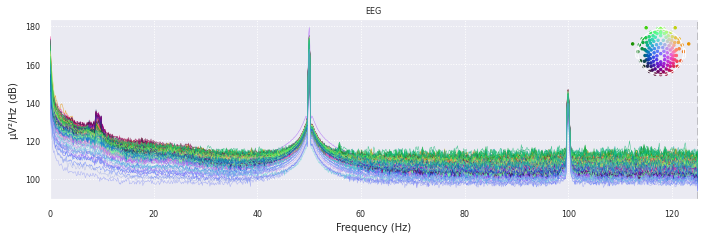

Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
Effective window size : 8.192 (s)


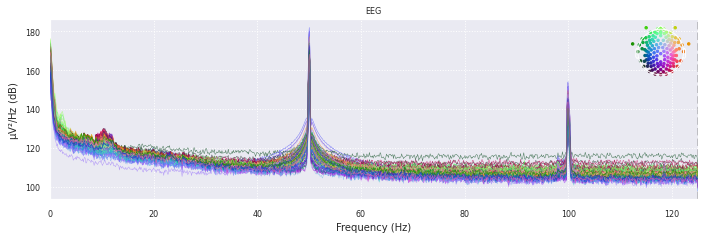

Creating RawArray with float64 data, n_channels=128, n_times=83876
    Range : 0 ... 83875 =      0.000 ...   335.500 secs
Ready.
Effective window size : 8.192 (s)


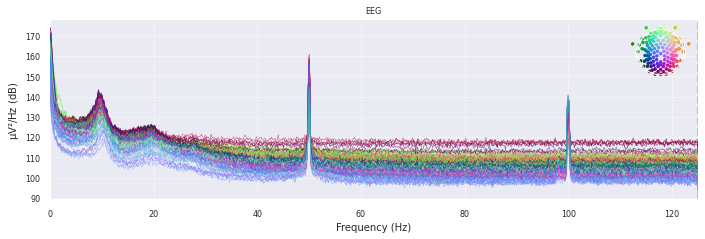

Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
Effective window size : 8.192 (s)


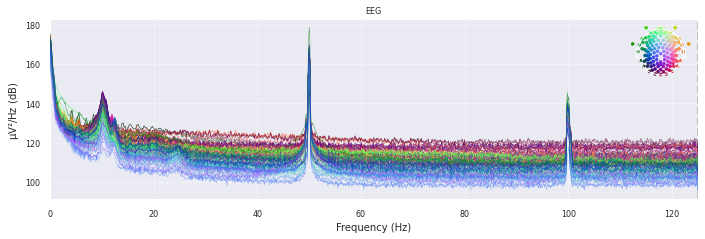

Creating RawArray with float64 data, n_channels=128, n_times=83164
    Range : 0 ... 83163 =      0.000 ...   332.652 secs
Ready.
Effective window size : 8.192 (s)


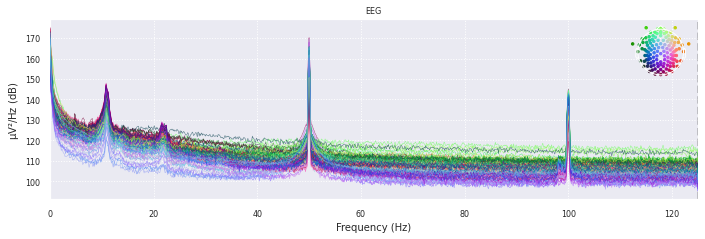

Creating RawArray with float64 data, n_channels=128, n_times=75114
    Range : 0 ... 75113 =      0.000 ...   300.452 secs
Ready.
Effective window size : 8.192 (s)


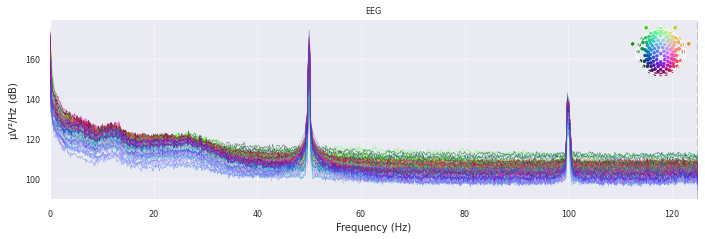

Creating RawArray with float64 data, n_channels=128, n_times=75525
    Range : 0 ... 75524 =      0.000 ...   302.096 secs
Ready.
Effective window size : 8.192 (s)


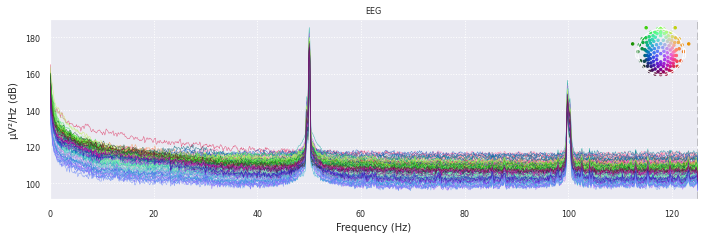

Creating RawArray with float64 data, n_channels=128, n_times=75151
    Range : 0 ... 75150 =      0.000 ...   300.600 secs
Ready.
Effective window size : 8.192 (s)


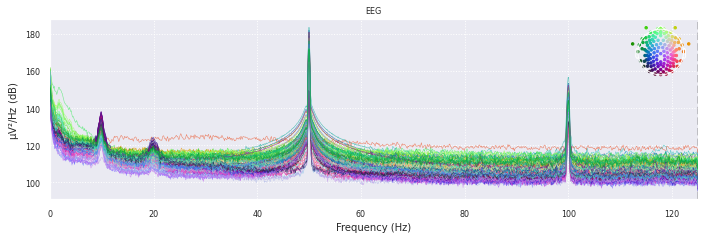

Creating RawArray with float64 data, n_channels=128, n_times=75513
    Range : 0 ... 75512 =      0.000 ...   302.048 secs
Ready.
Effective window size : 8.192 (s)


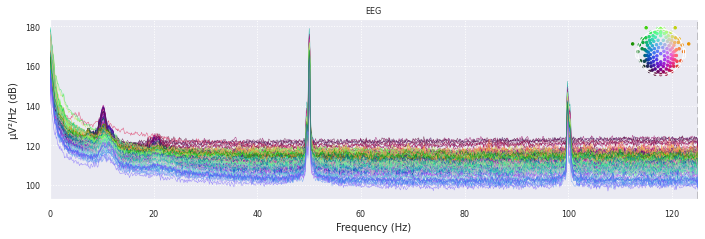

Creating RawArray with float64 data, n_channels=128, n_times=75126
    Range : 0 ... 75125 =      0.000 ...   300.500 secs
Ready.
Effective window size : 8.192 (s)


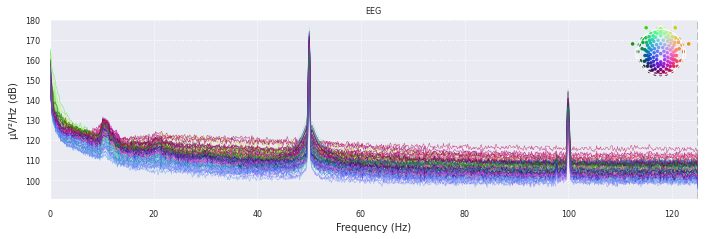

Creating RawArray with float64 data, n_channels=128, n_times=75688
    Range : 0 ... 75687 =      0.000 ...   302.748 secs
Ready.
Effective window size : 8.192 (s)


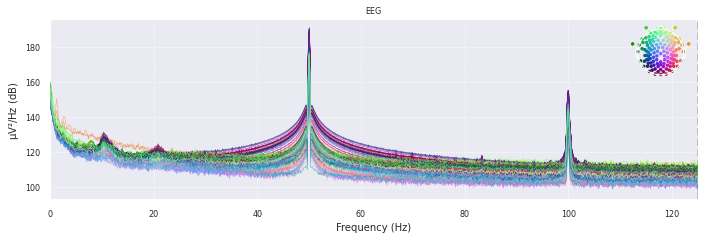

Creating RawArray with float64 data, n_channels=128, n_times=75750
    Range : 0 ... 75749 =      0.000 ...   302.996 secs
Ready.
Effective window size : 8.192 (s)


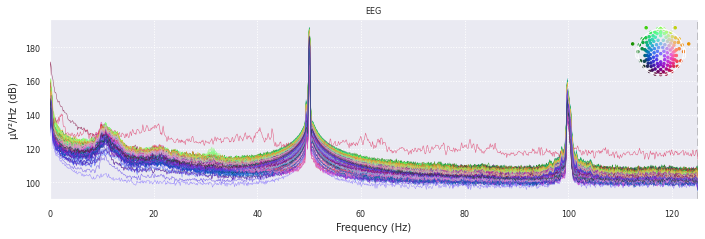

Creating RawArray with float64 data, n_channels=128, n_times=75139
    Range : 0 ... 75138 =      0.000 ...   300.552 secs
Ready.
Effective window size : 8.192 (s)


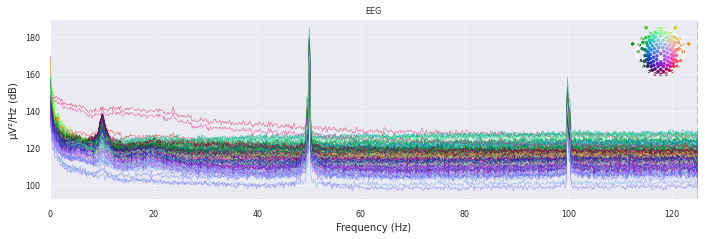

Creating RawArray with float64 data, n_channels=128, n_times=75188
    Range : 0 ... 75187 =      0.000 ...   300.748 secs
Ready.
Effective window size : 8.192 (s)


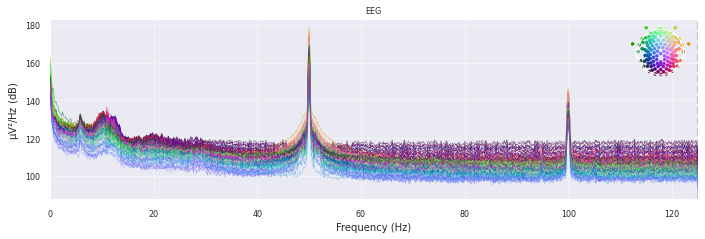

Creating RawArray with float64 data, n_channels=128, n_times=75158
    Range : 0 ... 75157 =      0.000 ...   300.628 secs
Ready.
Effective window size : 8.192 (s)


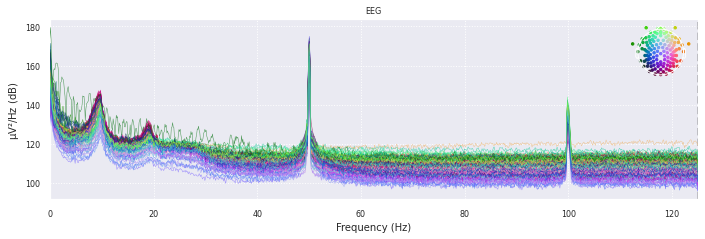

Creating RawArray with float64 data, n_channels=128, n_times=75164
    Range : 0 ... 75163 =      0.000 ...   300.652 secs
Ready.
Effective window size : 8.192 (s)


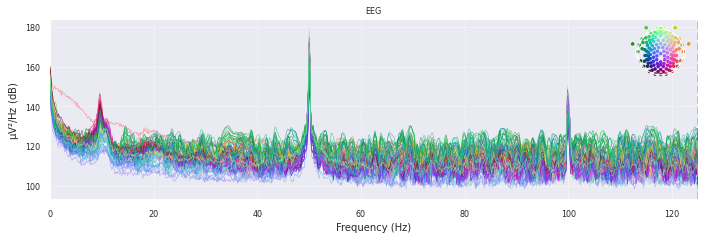

Creating RawArray with float64 data, n_channels=128, n_times=75113
    Range : 0 ... 75112 =      0.000 ...   300.448 secs
Ready.
Effective window size : 8.192 (s)


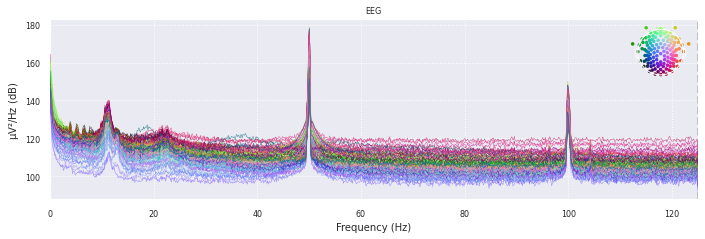

Creating RawArray with float64 data, n_channels=128, n_times=75127
    Range : 0 ... 75126 =      0.000 ...   300.504 secs
Ready.
Effective window size : 8.192 (s)


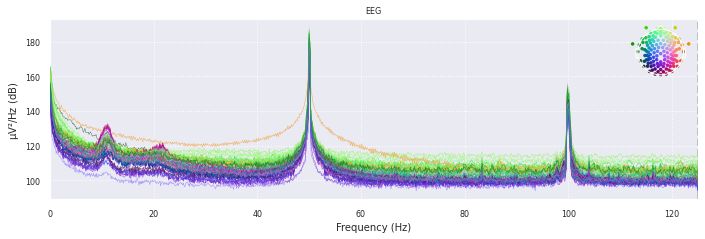

Creating RawArray with float64 data, n_channels=128, n_times=75275
    Range : 0 ... 75274 =      0.000 ...   301.096 secs
Ready.
Effective window size : 8.192 (s)


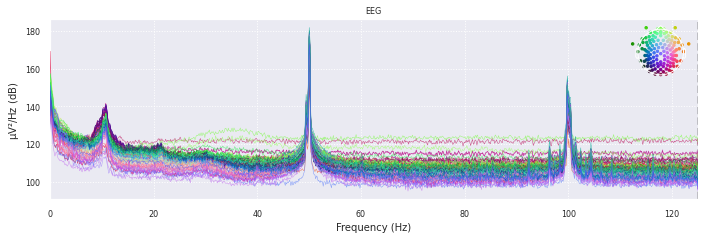

In [ ]:
final_patient_resting = pd.DataFrame()
ints = list(range(1,129))
ch_names = ['E'+str(int) for int in ints]

for root, dirs, files in os.walk("/content/drive/My Drive/dep_data/MODMA/EEG_128channels_resting_lanzhou_2015"):
  folder = "/content/drive/My Drive/dep_data/MODMA/EEG_128channels_resting_lanzhou_2015"
  for index, file in enumerate(files):
      if file[-3:]=='mat':
        fin = str(folder)+"/"+str(file)
        raw_trunct = file_importer(path=fin,type =0)
        result = raw_trunct.get_data()
        df = pd.DataFrame(data = result.T, columns = ch_names)
        df = df.filter(items=list(Electrode_map.values()))
        df.reset_index(inplace = True)
        df = df.rename(columns = {'index': 'Time'})
        df['patient'] = file[:8]
        # Loading only 30 secs of data
        df = df.iloc[14999:22999,:]
        final_patient_resting = pd.concat([final_patient_resting,df],axis = 0)

In [ ]:
# # from all the emotions, fear poses a significant impact on the overall depression prediction. So looking at fear impact.

# final_patient_fear = pd.DataFrame()
# for root, dirs, files in os.walk("/content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015"):
#   folder = "/content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015"
#   for index, file in enumerate(files):
#       if file[-3:]=='raw':
#         fin = str(folder)+"/"+str(file)
#         df = file_importer(fin)
#         fear,happy,sad = channel_explorer(df)

#         fear_df = fear.get_data()
#         fear_col = fear.ch_names
#         df_fear = pd.DataFrame(data = fear_df.T, columns = fear_col)
#         df_fear = df_fear.filter(items=list(Electrode_map.values()))
#         df_fear.reset_index(inplace = True)
#         df_fear = df_fear.rename(columns = {'index': 'Time'})
#         df_fear['patient'] = file[:8]
#         df_fear = df_fear.iloc[14999:22999,:]
#         final_patient_fear = pd.concat([final_patient_fear,df_fear],axis = 0)

In [ ]:
# Importing the target data to identify patients that are healthy and patients with MDD.
df_demo = pd.read_excel('/content/drive/My Drive/dep_data/MODMA/EEG_128channels_resting_lanzhou_2015/subjects_information_EEG_128channels_resting_lanzhou_2015.xlsx')
df_demo =  df_demo.iloc[: , :-2]

df_type = pd.get_dummies(df_demo["type"])
df_demo = pd.concat((df_demo, df_type), axis=1)
df_demo = df_demo.drop(["type"], axis=1)
df_demo = df_demo.drop(["HC"], axis=1) #MDD = 1; HC = 0

# Data collected during resting phase
final_patient_resting['patient'] = pd.to_numeric(final_patient_resting['patient'])
final_patient_resting_30sec = final_patient_resting

df2 = final_patient_resting_30sec.melt(id_vars=["Time","patient"], 
        var_name="Electrode", 
        value_name="Value")
df2['patient'] = pd.to_numeric(df2['patient'])
df_fin = pd.merge(df2, df_demo[['subject id','MDD']], left_on='patient', right_on='subject id')

# # Data collected when the subjects were shown fear stimuli
# df_fear = final_patient_fear.melt(id_vars=["Time","patient"], 
#         var_name="Electrode", 
#         value_name="Value")

# df_fear['patient'] = pd.to_numeric(df_fear['patient'])
# df_fin_fear = pd.merge(df_fear, df_demo[['subject id','MDD']], left_on='patient', right_on='subject id')

In [ ]:
final_patient_df.to_csv('/content/drive/My Drive/dep_data/MODMA/ERP_Summary_limited.csv',index = False)
final_patient_resting.to_csv('/content/drive/My Drive/dep_data/MODMA/Resting_Summary_limited.csv',index = False)

# Classification

### Import data for ML models

In [ ]:
#Import ERP dataframe
df_erp = pd.read_csv('/content/drive/My Drive/H/ERP_Summary_limited.csv')
#Import Resting dataframe
df_resting = pd.read_csv('/content/drive/My Drive/H/Resting_Summary_limited.csv')
#Import demographics table
df_demog = pd.read_excel('/content/drive/My Drive/dep_data/MODMA/EEG_128channels_ERP_lanzhou_2015/subjects_information_EEG_128channels_ERP_lanzhou_2015.xlsx',sheet_name = 'Sheet1')

In [ ]:
#Lets first create a patient identifier key
df_erp['patient_identifier']= [i[:8] for i in df_erp['patient_identifier']]
df_erp['patient_identifier'] = df_erp['patient_identifier'].astype(int)
df_resting['patient_identifier']= [i[:8] for i in df_resting['patient_identifier']]
df_resting['patient_identifier'] = df_resting['patient_identifier'].astype(int)

In [ ]:
#Combining the datasets
#Step - 1: Merge demog data
intermediate_df = pd.merge(df_erp,df_demog,left_on = 'patient_identifier',right_on = 'subject id',how ='inner')
#Merge Resting data
df = pd.merge(intermediate_df,df_resting,left_on = 'patient_identifier',right_on = 'patient_identifier',how ='inner')

df.set_index('patient_identifier',inplace=True)
df.drop(columns = ['Unnamed: 11', 'Unnamed: 12','subject id'],inplace = True)

In [ ]:
#Explore the dataset
print("# of Patients:"+str(df.shape[0]))
print("******Understading Features******")
print("# of Electrode:16")
print("\n***Linear Features***")
print("# of Linear Features by emotion (Fear, Happy, Sad, Resting)\n16 Electrodes*8 features :"+str(len([i for i in df.columns if 'lf' in i and 'fear' in i])))
print("# of Total Linear Features\n16 Electrodes*8 features*4 Emotions:"+str(len([i for i in df.columns if 'lf' in i])))
print("\n***Non Linear Features***")
print("# of Non Features by emotion (Fear, Happy, Sad, Resting)\n16 Electrodes*3 features:"+str(len([i for i in df.columns if 'nl' in i and 'fear' in i])))
print("# of Non Linear Features\n:16 Electrodes*3 features*4 Emotions :"+str(len([i for i in df.columns if 'nl' in i])))
print("\n***Rest of the Features***")
print("# of Other Features:"+str(714-len([i for i in df.columns if 'nl' in i or 'lf' in i])))
print("\n***Total Features***")
print("# of Total Features (512+192+10):"+str(df.shape[1]))
df.head()

# of Patients:53
******Understading Features******
# of Electrode:16

***Linear Features***
# of Linear Features by emotion (Fear, Happy, Sad, Resting)
16 Electrodes*8 features :128
# of Total Linear Features
16 Electrodes*8 features*4 Emotions:512

***Non Linear Features***
# of Non Features by emotion (Fear, Happy, Sad, Resting)
16 Electrodes*3 features:48
# of Non Linear Features
:16 Electrodes*3 features*4 Emotions :192

***Rest of the Features***
# of Other Features:10

***Total Features***
# of Total Features (512+192+10):714


,lf_alpha_fear_E36,lf_beta_fear_E36,lf_delta_fear_E36,lf_theta_fear_E36,lf_mean_fear_E36,lf_max_fear_E36,lf_min_fear_E36,lf_median_fear_E36,lf_alpha_happy_E36,lf_beta_happy_E36,...,lf_beta_resting_E96,lf_delta_resting_E96,lf_theta_resting_E96,lf_mean_resting_E96,lf_max_resting_E96,lf_min_resting_E96,lf_median_resting_E96,nl_svden_resting_E96,nl_spec_enresting_E96,nl_permenresting_E96
patient_identifier,,,,,,,,,,,,,,,,,,,,,
2010008,0.003473,0.003368,0.015247,0.007565,0.059222,517.229278,0.000041,0.003682,0.002941,0.001625,...,8990.789709,79698.436736,29945.553683,111923.551768,8.038292e+08,414.748991,8716.870511,0.293716,0.339961,0.692474
2010011,0.004254,0.002348,0.016904,0.006377,0.089253,867.522513,0.000025,0.002415,0.002548,0.002193,...,4839.226925,25285.119665,9797.788046,85590.059405,8.093862e+08,2.808689,4743.683717,0.548817,0.469027,0.709035
2010015,0.001797,0.001225,0.005069,0.002325,0.011508,60.477420,0.000012,0.001242,0.002351,0.001448,...,3101.825351,24831.077259,9134.868438,65408.248917,5.234847e+08,7.695048,3132.808279,0.282948,0.341356,0.700097
2010013,0.002016,0.001013,0.003829,0.002445,0.024019,241.903701,0.000014,0.001012,0.003692,0.001926,...,1670.780659,10659.439181,4828.711243,43732.055011,4.401827e+08,15.352059,1535.344760,0.477561,0.537580,0.833365
2010012,0.009081,0.004736,0.040018,0.015150,0.038334,180.524548,0.000026,0.005003,0.003708,0.002653,...,12476.861737,110306.351382,41684.525211,115273.109337,5.478030e+08,1951.364364,12226.153795,0.411179,0.455350,0.747001


## correlation

### linear features

In [ ]:
df.columns

Index(['lf_alpha_fear_E36', 'lf_beta_fear_E36', 'lf_delta_fear_E36',
       'lf_theta_fear_E36', 'lf_mean_fear_E36', 'lf_max_fear_E36',
       'lf_min_fear_E36', 'lf_median_fear_E36', 'lf_alpha_happy_E36',
       'lf_beta_happy_E36',
       ...
       'lf_beta_resting_E96', 'lf_delta_resting_E96', 'lf_theta_resting_E96',
       'lf_mean_resting_E96', 'lf_max_resting_E96', 'lf_min_resting_E96',
       'lf_median_resting_E96', 'nl_svden_resting_E96',
       'nl_spec_enresting_E96', 'nl_permenresting_E96'],
      dtype='object', length=714)

In [ ]:
#Helper function - Purpose is to extract necessary column from the dataframe as per set initialized and plot correlation map of 16 electodes
#Also provide a view on how they differ between Depression and Normal patient

def columns_extractor(df,emotion,feature_type,name):
  """
  Inputs:
  df - Dataframe that we are using
  emotion - There are four emotions namely : Happy, Fear, Sad and Resting
  Feature - Either Linear feature (lf) or Non-linear features (nl)
  Outputs:
  resultant data frame
  """
  if feature_type =='lf':
    columns_to_extract = [i for i in df.columns if feature_type in i and emotion in i and name in i]
    final_cols = {i:i.replace(feature_type+'_'+name+'_'+emotion+'_', '') for i in columns_to_extract}
  else:
    columns_to_extract = [i for i in df.columns if feature_type in i and name in i and emotion in i]
    final_cols = {i:i.replace(feature_type+'_'+name+emotion+'_', '') for i in columns_to_extract}
  columns_to_extract.extend(['type'])
  #print(columns_to_extract)
  df_result = df[columns_to_extract]
  return df_result.rename(columns = final_cols)

def correlation_builder(df,prefix):
  """
  Inputs:
  df - Dataframe to be used
  Outputs:
  chart object - This will be saved for future reference
  """
  #Correlation cross tab
  corr_all = df[[i for i in df.columns if 'type' not in i]].corr()
  corr_md = df[df['type']=='MDD'][[i for i in df.columns if 'type' not in i]].corr()
  corr_hc = df[df['type']=='HC'][[i for i in df.columns if 'type' not in i]].corr()
  list_corr = [corr_all,corr_md,corr_hc]
  titles = ['All Participants','MDD','HC']
  #Mask for the upper triangle of correlation to be masked
  mask = np.zeros_like(corr_all)
  mask[np.triu_indices_from(mask)] = True
  min = -1
  max = 1
  a = dict()
  # fig =  plt.figure(figsize=(30,12))
  # for val in range(3):    
  #   with sns.axes_style("white"):
  #     a[val] = fig.add_subplot(1,3,val+1)
  #     a[val] = sns.heatmap(list_corr[val], mask=mask, square=True,vmin=min,vmax=max,cmap = sns.cm.rocket_r,
  #                          cbar_kws = dict(use_gridspec=False,location="bottom"))
  #     a[val].set_title(titles[val],fontdict={'fontsize': '20', 'fontweight' : '5'})
  
  #sns.heatmap(arr, ax=ax, cbar_ax = cbar_ax, cbar=True)
  # fig.suptitle('Heat Map for '+prefix, fontsize=30)
  # path_to_save = '/content/drive/My Drive/H/Images/EA_'+prefix+'.png'
  # fig.savefig(path_to_save,dpi = 100)
  return corr_all

def column_eliminator(df,thr=0.9):
  columns = np.full((df.shape[0],), True, dtype=bool)
  for i in range(df.shape[0]):
      for j in range(i+1, df.shape[0]):
          if df.iloc[i,j] >= thr:
              if columns[j]:
                  columns[j] = False
  return columns

In [ ]:
columns_to_keep = []
for emotion in ['happy','sad','fear','resting']:
  for name in ['max','min','mean','median','alpha','beta','delta','theta']:
    temp = columns_extractor(df,emotion,'lf',name)
    a = correlation_builder(temp,prefix = 'Linear feature '+emotion+'_'+name)
    temp.drop(columns = 'type',inplace=True)
    columns_to_keep.extend(['lf_'+name+'_'+emotion+'_'+i for i in temp.columns[column_eliminator(a,thr = 0.8)]])

In [ ]:
len(columns_to_keep)

259

In [ ]:
for i in ['happy','fear','sad','resting']:
  for j in ['alpha','beta','delta','theta']:
    df['lf'+'_'+i+'_'+j] = np.mean(df[[x for x in df.columns if 'lf' in x and i in x and j in x]],axis = 1)

In [ ]:
for i in ['happy','fear','sad','resting']:
  for j in ['mean','median','min','max']:
    df['lf'+'_'+i+'_'+j] = np.mean(df[[x for x in df.columns if 'lf' in x and i in x and j in x]],axis = 1)

In [ ]:
# fig = plt.figure(figsize=(20,10))
# a = dict()
# i = 0
# for emotion in ['happy','fear','sad','resting']:
#   for signal in ['mean','median','max','min']:
#     a[i] = fig.add_subplot(4,4,i+1)
#     sns.boxplot(x='lf'+'_'+emotion+'_'+signal, y="type",data = df,width=.6,ax = a[i])
#     a[i].set(ylabel=emotion,xlabel = '',title = signal)
#     i = i + 1
# fig.tight_layout()

### non-linear features

In [ ]:
emotion = 'fear'
for emotion in ['happy','sad','fear','resting']:
  for name in ['svden_','spec_en','permen']:
    temp = columns_extractor(df,emotion,'nl',name)
    a = correlation_builder(temp,prefix = 'Non Linear feature '+emotion+'_'+name)
    temp.drop(columns = 'type',inplace=True)
    columns_to_keep.extend(['nl_'+name+emotion+'_'+i for i in temp.columns[column_eliminator(a,thr = 0.8)]])

In [ ]:
len(columns_to_keep)

330

In [ ]:
df.shape

(53, 746)

In [ ]:
df.to_csv('/content/drive/My Drive/audio_data/eeg_df.csv')

In [ ]:
#flag MDD and HC patients. 
df.type.replace({'MDD':1,'HC':0},inplace=True)

# drop Gender column
df.drop(columns = 'gender',inplace=True)

In [ ]:
#Lets divide the data set into test and train. Here we have to create a stratified
#sample to create the train and test datasets. While we can use the native SCIKIT learn
#Test, Train splits, we are going to write a custom code here
sample = df.groupby('type', group_keys=False).apply(lambda x: x.sample(round(30*0.7),random_state=42))
left_over = df[~(df.index.isin(list(sample.index)))]

In [ ]:
X, X_test, y, y_test = train_test_split(X, y, test_size=0.2, random_state = 42)

In [ ]:
#Lets create the variables for test and train
y = sample['type']
X = sample.drop(columns = 'type')
X_test = left_over.drop(columns = 'type')
y_test = left_over['type']

##LDA

In [ ]:
#Eliminate columns that have more than threshold correlation between them
df_lda = df[columns_to_keep]

columns_to_consider = list(df_lda.columns[column_eliminator(df_lda.corr(),thr = 0.8)])

In [ ]:
#Final Set of columns for the exercise - Total of 89 columns are used 
X = X[columns_to_consider]
X_test = X_test[columns_to_consider]

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_scale = sc.fit(X).transform(X)
X_scale_test = sc.transform(X_test)

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
# lda = LDA(n_components = 1)
lda = LDA()

lda_X_train = lda.fit_transform(X_scale, y)


In [ ]:
lda_X_test = lda.transform(X_scale_test)

## Classification Models

In [ ]:
import xgboost as xgb
from xgboost import XGBClassifier
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe, space_eval

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
from sklearn.ensemble import BaggingClassifier

In [ ]:
def hyperopt_xgb_score(params):
    clf = XGBClassifier(**params)
    current_score = cross_val_score(clf, X, y, cv=10).mean()
    print(current_score, params)
    return current_score 
 
space_xgb = {
            'learning_rate': hp.quniform('learning_rate', 0, 0.05, 0.0001),
            'n_estimators': hp.choice('n_estimators', range(100, 1000)),
            'eta': hp.quniform('eta', 0.025, 0.5, 0.005),
            'max_depth':  hp.choice('max_depth', np.arange(2, 12, dtype=int)),
            'min_child_weight': hp.quniform('min_child_weight', 1, 9, 0.025),
            'subsample': hp.quniform('subsample', 0.5, 1, 0.005),
            'gamma': hp.quniform('gamma', 0.5, 1, 0.005),
            'colsample_bytree': hp.quniform('colsample_bytree', 0.5, 1, 0.005),
            'eval_metric': 'auc',
            'objective': 'binary:logistic',
            'booster': 'gbtree',
            'tree_method': 'exact',
            'silent': 1,
            'missing': None
        }
 
best = fmin(fn=hyperopt_xgb_score, space=space_xgb, algo=tpe.suggest, max_evals=10)

0.48
{'booster': 'gbtree', 'colsample_bytree': 0.765, 'eta': 0.215, 'eval_metric': 'auc', 'gamma': 0.51, 'learning_rate': 0.0268, 'max_depth': 9, 'min_child_weight': 4.8500000000000005, 'missing': None, 'n_estimators': 713, 'objective': 'binary:logistic', 'silent': 1, 'subsample': 0.515, 'tree_method': 'exact'}
0.595
{'booster': 'gbtree', 'colsample_bytree': 0.525, 'eta': 0.28500000000000003, 'eval_metric': 'auc', 'gamma': 0.795, 'learning_rate': 0.0118, 'max_depth': 11, 'min_child_weight': 1.8250000000000002, 'missing': None, 'n_estimators': 896, 'objective': 'binary:logistic', 'silent': 1, 'subsample': 0.6900000000000001, 'tree_method': 'exact'}
0.52
{'booster': 'gbtree', 'colsample_bytree': 0.81, 'eta': 0.435, 'eval_metric': 'auc', 'gamma': 0.985, 'learning_rate': 0.0182, 'max_depth': 2, 'min_child_weight': 1.2000000000000002, 'missing': None, 'n_estimators': 462, 'objective': 'binary:logistic', 'silent': 1, 'subsample': 0.86, 'tree_method': 'exact'}
0.27999999999999997
{'booster': 

In [ ]:
params = space_eval(space_xgb, best)

In [ ]:
XGB_Classifier = XGBClassifier(**params)

In [ ]:
def classifier(X,y,X_test,y_test):
  """
  Input:

  X - Training set
  y - Training outcome
  X_test - Test set
  y_test - Test outcome
  
  Output :
  total - dictionary summarizing performances of various models

  """
  total = dict()
  rf = RandomForestClassifier(random_state=42)
  lr = LogisticRegression(random_state=42)
  svc = SVC(random_state=42)
  xgb = XGB_Classifier
  bg = BaggingClassifier()
  dt = DecisionTreeClassifier()
  
  model_array = [rf,lr,svc,xgb,bg,dt]
  model_vals = ['Random Forest','Logistic Regression','SVC','XGB','bg','DT']
  i = 0
  for clf in model_array:
    result = dict()
    kfold = StratifiedKFold(n_splits=10, random_state=42, shuffle=True)
    cv_results = cross_val_score(clf, X, y, cv=kfold, scoring='accuracy')
    clf.fit(X, y)
    y_pred = clf.predict(X_test)
    result['accuracy']=round(accuracy_score(y_test, y_pred),2)
    result['precision']=round(precision_score(y_test, y_pred),2)
    result['recall']=round(recall_score(y_test, y_pred),2)

    print("predictions: ", y_pred)
    print("classifier: ", clf)
    print(classification_report(y_test, y_pred))

    total[model_vals[i]]=result
    i = i+1
    
  return total

In [ ]:
lda_result = pd.DataFrame(classifier(lda_X_train,y,lda_X_test,y_test))
lda_result['base'] = 'PCA factors'
lda_result['emotion'] = 'all'

predictions:  [1 0 0 0 0 1 1 1 1 1 0]
classifier:  RandomForestClassifier(random_state=42)
              precision    recall  f1-score   support

           0       0.60      0.38      0.46         8
           1       0.17      0.33      0.22         3

    accuracy                           0.36        11
   macro avg       0.38      0.35      0.34        11
weighted avg       0.48      0.36      0.40        11

predictions:  [1 0 0 0 0 0 1 1 0 1 0]
classifier:  LogisticRegression(random_state=42)
              precision    recall  f1-score   support

           0       0.71      0.62      0.67         8
           1       0.25      0.33      0.29         3

    accuracy                           0.55        11
   macro avg       0.48      0.48      0.48        11
weighted avg       0.59      0.55      0.56        11

predictions:  [1 0 0 0 0 0 1 1 0 1 0]
classifier:  SVC(random_state=42)
              precision    recall  f1-score   support

           0       0.71      0.62      0.

In [ ]:
final =lda_result.reset_index()

In [ ]:
print(final)

       index  Random Forest  Logistic Regression   SVC   XGB    bg    DT  \
0   accuracy           0.36                 0.55  0.55  0.55  0.36  0.36   
1  precision           0.17                 0.25  0.25  0.25  0.17  0.17   
2     recall           0.33                 0.33  0.33  0.33  0.33  0.33   

          base emotion  
0  PCA factors     all  
1  PCA factors     all  
2  PCA factors     all  


In [ ]:
Vals = list(X.columns)

In [ ]:
for emotion in ['fear','sad','happy','resting','erp','all']:
  for type_vars in ['nl','lf','all']:  
    print("\n\n emotion: ", emotion)
    print("features: ", type_vars)
    if emotion =='erp':
      indices_to_keep = [i for i in range(len(Vals)) if type_vars in Vals[i] and 'resting' not in Vals[i]]
      if type_vars =='all':
        indices_to_keep = [i for i in range(len(Vals)) if 'resting' not in Vals[i]]
    elif emotion =='all':
      indices_to_keep = [i for i in range(len(Vals)) if type_vars in Vals[i]]
      if type_vars =='all':
        indices_to_keep = [i for i in range(len(Vals))]
    else:
      indices_to_keep = [i for i in range(len(Vals)) if type_vars in Vals[i] and emotion in Vals[i]]
      if type_vars =='all':
        indices_to_keep = [i for i in range(len(Vals)) if emotion in Vals[i]]
      

    temp = classifier(X_scale[:,indices_to_keep],y,X_scale_test[:,indices_to_keep],y_test)
    temp['base'] = type_vars
    temp['emotion'] = emotion
    final = pd.concat([final,pd.DataFrame(temp).reset_index()],axis = 0)
    print(temp)



 emotion:  fear
features:  nl
predictions:  [1 0 1 0 1 1 1 1 1 0 1]
classifier:  RandomForestClassifier(random_state=42)
              precision    recall  f1-score   support

           0       0.67      0.25      0.36         8
           1       0.25      0.67      0.36         3

    accuracy                           0.36        11
   macro avg       0.46      0.46      0.36        11
weighted avg       0.55      0.36      0.36        11

predictions:  [1 0 1 0 1 0 0 1 0 1 0]
classifier:  LogisticRegression(random_state=42)
              precision    recall  f1-score   support

           0       0.67      0.50      0.57         8
           1       0.20      0.33      0.25         3

    accuracy                           0.45        11
   macro avg       0.43      0.42      0.41        11
weighted avg       0.54      0.45      0.48        11

predictions:  [1 0 0 0 0 0 0 0 0 1 0]
classifier:  SVC(random_state=42)
              precision    recall  f1-score   support

         

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


predictions:  [0 0 0 0 1 0 1 0 0 1 0]
classifier:  RandomForestClassifier(random_state=42)
              precision    recall  f1-score   support

           0       0.62      0.62      0.62         8
           1       0.00      0.00      0.00         3

    accuracy                           0.45        11
   macro avg       0.31      0.31      0.31        11
weighted avg       0.45      0.45      0.45        11

predictions:  [0 0 1 0 0 1 0 0 0 1 1]
classifier:  LogisticRegression(random_state=42)
              precision    recall  f1-score   support

           0       0.71      0.62      0.67         8
           1       0.25      0.33      0.29         3

    accuracy                           0.55        11
   macro avg       0.48      0.48      0.48        11
weighted avg       0.59      0.55      0.56        11

predictions:  [0 0 1 0 0 0 1 0 1 1 1]
classifier:  SVC(random_state=42)
              precision    recall  f1-score   support

           0       0.67      0.50      0.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
final.to_csv('/content/drive/My Drive/H/Model_results.csv')

In [ ]:
columns = ['RF','LR','SVC','XGB','bg','dt','base']
dict_changer = {'Random Forest':'RF','Logistic Regression':'LR','SVC':'SVC','XGB':'XGB','bg':'bg','dt':'dt'}
final.rename(columns = dict_changer,inplace = True)

In [ ]:
# final['emotion'] = np.where(final['base']=='PCA factors','PCA factors',final['emotion'])
final['base'] = np.where(final['base']=='PCA factors','all',final['base'])

In [ ]:
for i in list(final['emotion'].unique()):
  print(final[(final['index']=='accuracy')&(final['emotion']==i)])

      index    RF    LR   SVC   XGB    bg    DT base emotion
0  accuracy  0.36  0.55  0.55  0.55  0.36  0.36  all     all
0  accuracy  0.27  0.55  0.36  0.55  0.45  0.27   nl     all
0  accuracy  0.45  0.55  0.73  0.73  0.45  0.73   lf     all
0  accuracy  0.55  0.64  0.73  0.82  0.55  0.27  all     all
      index    RF    LR   SVC   XGB    bg    DT base emotion
0  accuracy  0.36  0.45  0.73  0.45  0.55  0.45   nl    fear
0  accuracy  0.64  0.45  0.36  0.64  0.55  0.64   lf    fear
0  accuracy  0.73  0.45  0.36  0.73  0.64  0.73  all    fear
      index    RF    LR   SVC   XGB    bg    DT base emotion
0  accuracy  0.27  0.45  0.45  0.55  0.55  0.55   nl     sad
0  accuracy  0.73  0.82  0.45  0.64  0.82  0.55   lf     sad
0  accuracy  0.64  0.73  0.45  0.55  0.55  0.55  all     sad
      index    RF    LR   SVC   XGB    bg    DT base emotion
0  accuracy  0.64  0.36  0.27  0.36  0.64  0.45   nl   happy
0  accuracy  0.55  0.55  0.36  0.64  0.82  0.55   lf   happy
0  accuracy  0.45  0.55 

In [ ]:
def metric_analyzer(df,model='RF',emotion='all',base='all',measure='accuracy'):
  """
  Inputs:
  df - Dataframe to be used
  model - model to be plotted
  emotion - type of emotion needed
  base - type of feature space use
  measure - Are we going to choose Accuracy / Precision / Recall
  Outputs:
  chart object - This will be saved for future reference
  """
  #Filter the resultant data frame
  fig = plt.figure(figsize = (20, 5))
  a = dict()
  text = ['All Features','Non Linear Features','Linear Features']
  val = 0
  for base in df.base.unique():
    a[val] = fig.add_subplot(1,3,val+1)
    df_final = df[(df['base']==base)&(df['index']==measure)][['emotion',model]].sort_values('RF',ascending = False)
    df_final.replace({'PCA factors':'PCA'},inplace=True)
    X = df_final.emotion.values
    Y = df_final[model].values
    a[val].bar(X, Y, width = 0.4)
    a[val].set_ylim(0,1)
    a[val].set_title('\n'+text[val])
    a[val].hlines(df_final[df_final['emotion']=='all'][model].values[0],0,7)
    a[val].text(2, df_final[df_final['emotion']=='all'][model].values[0]+0.05, 'Better than Base line\n(All emotions model)', rotation=0)
    #a[val].set_xticks(rotation = 90)
    val = val+1
  fig.suptitle(measure.upper()+' of various feature types (model='+model+')')
  path_to_save = '/content/drive/My Drive/H/Images/Model_'+model+'.png'
  fig.savefig(path_to_save,dpi = 100)

In [ ]:
final.to_csv('/content/drive/My Drive/H/Model_results.csv')

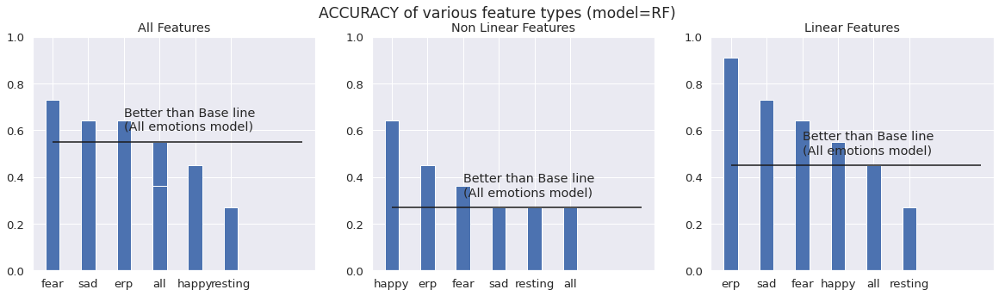

In [ ]:
metric_analyzer(final)